# MSC Dissertation - Superstore Sales Time Series Forecasting

In [1]:
# Libraries
import random
import warnings
import itertools
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from prettytable import PrettyTable
from sklearn.preprocessing import OrdinalEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from prophet import Prophet
from sklearn.svm import SVR
from xgboost import XGBRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'last'
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import tensorflow as tf
from tensorflow import keras
from keras import metrics
from tensorflow.keras.layers import Dropout,LSTM, BatchNormalization, Dense
from tensorflow.keras.optimizers import SGD, Adam 
from tensorflow.keras import callbacks
from keras.callbacks import ReduceLROnPlateau
from statsmodels.tools.sm_exceptions import  ValueWarning
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA

In [2]:
# Importing dataset
train_df = pd.read_csv("train.csv")
holidays_df = pd.read_csv("holidays_events.csv")
oil_df = pd.read_csv("oil.csv")
stores_df = pd.read_csv("stores.csv")

In [3]:
# Function to create table
def prettyTable(dataframe):
    table = PrettyTable()
    table.field_names = ['Column Name', 'Data Type', 'Null Count']
    for col in dataframe.columns:
        dataType = str(dataframe[col].dtype)
        nullCount = dataframe[col].isnull().sum()
        table.add_row([col, dataType, nullCount])
    return table

# Data Preprocessing

## Data Cleaning

### Train dataset

In [4]:
# Checking data information
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000888 entries, 0 to 3000887
Data columns (total 6 columns):
 #   Column       Dtype  
---  ------       -----  
 0   id           int64  
 1   date         object 
 2   store_nbr    int64  
 3   family       object 
 4   sales        float64
 5   onpromotion  int64  
dtypes: float64(1), int64(3), object(2)
memory usage: 137.4+ MB


In [5]:
# Converting date object to datetime
train_df['date'] = pd.to_datetime(train_df['date'])

In [6]:
# Checking for sum of na values
train_df.isna().sum()

id             0
date           0
store_nbr      0
family         0
sales          0
onpromotion    0
dtype: int64

In [7]:
# Checking for null values
train_df.isnull().all()

id             False
date           False
store_nbr      False
family         False
sales          False
onpromotion    False
dtype: bool

In [8]:
# Checking for Duplicate values
train_df.duplicated().sum()

0

In [9]:
train_df.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0


In [10]:
train_df['store_nbr'].unique()

array([ 1, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,  2, 20, 21, 22, 23, 24,
       25, 26, 27, 28, 29,  3, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39,  4,
       40, 41, 42, 43, 44, 45, 46, 47, 48, 49,  5, 50, 51, 52, 53, 54,  6,
        7,  8,  9], dtype=int64)

In [11]:
train_df['family'].unique()

array(['AUTOMOTIVE', 'BABY CARE', 'BEAUTY', 'BEVERAGES', 'BOOKS',
       'BREAD/BAKERY', 'CELEBRATION', 'CLEANING', 'DAIRY', 'DELI', 'EGGS',
       'FROZEN FOODS', 'GROCERY I', 'GROCERY II', 'HARDWARE',
       'HOME AND KITCHEN I', 'HOME AND KITCHEN II', 'HOME APPLIANCES',
       'HOME CARE', 'LADIESWEAR', 'LAWN AND GARDEN', 'LINGERIE',
       'LIQUOR,WINE,BEER', 'MAGAZINES', 'MEATS', 'PERSONAL CARE',
       'PET SUPPLIES', 'PLAYERS AND ELECTRONICS', 'POULTRY',
       'PREPARED FOODS', 'PRODUCE', 'SCHOOL AND OFFICE SUPPLIES',
       'SEAFOOD'], dtype=object)

### Holidays dataset

In [12]:
# Checking data information
holidays_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 350 entries, 0 to 349
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   date         350 non-null    object
 1   type         350 non-null    object
 2   locale       350 non-null    object
 3   locale_name  350 non-null    object
 4   description  350 non-null    object
 5   transferred  350 non-null    bool  
dtypes: bool(1), object(5)
memory usage: 14.1+ KB


In [13]:
# Converting date object to datetime
holidays_df['date'] = pd.to_datetime(holidays_df['date'])

In [14]:
# Checking for sum of na values
holidays_df.isna().sum()

date           0
type           0
locale         0
locale_name    0
description    0
transferred    0
dtype: int64

In [15]:
# Checking for null values
holidays_df.isnull().all()

date           False
type           False
locale         False
locale_name    False
description    False
transferred    False
dtype: bool

In [16]:
# Checking for Duplicate values
holidays_df.duplicated().sum()

0

In [17]:
# Dataframe head
holidays_df.head()

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [18]:
# Unique values
holidays_df['type'].unique()

array(['Holiday', 'Transfer', 'Additional', 'Bridge', 'Work Day', 'Event'],
      dtype=object)

In [19]:
# Unique values
holidays_df['locale'].unique()

array(['Local', 'Regional', 'National'], dtype=object)

In [20]:
# Number of unique values
holidays_df['locale_name'].unique().size

24

In [21]:
# Unique values
holidays_df['transferred'].unique()

array([False,  True])

### Oil dataset

In [22]:
# Checking data information
oil_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1218 entries, 0 to 1217
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   date        1218 non-null   object 
 1   dcoilwtico  1175 non-null   float64
dtypes: float64(1), object(1)
memory usage: 19.2+ KB


In [23]:
# Converting date object to datetime
oil_df['date'] = pd.to_datetime(oil_df['date'])

In [24]:
# Checking for sum of na values
oil_df.isna().sum()

date           0
dcoilwtico    43
dtype: int64

In [25]:
# Checking for null values
oil_df.isnull().all()

date          False
dcoilwtico    False
dtype: bool

In [26]:
# Checking for Duplicate values
oil_df.duplicated().sum()

0

In [27]:
# Dataframe head
oil_df.head()

,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


#### Handling missing values

In [28]:
# Create a DataFrame with all dates in the range
date_range = pd.date_range(start = oil_df['date'].iloc[0], end = oil_df['date'].iloc[-1])
dates_oil = pd.DataFrame({'date': date_range})

# Merging with the oil dataframe to retain all dates
oil_df = pd.merge(dates_oil, oil_df, on='date', how='left')

# Table
print(prettyTable(oil_df))

+-------------+----------------+------------+
| Column Name |   Data Type    | Null Count |
+-------------+----------------+------------+
|     date    | datetime64[ns] |     0      |
|  dcoilwtico |    float64     |    529     |
+-------------+----------------+------------+


In [29]:
# Imputing missing values using linear interpolation method
oil_df['dcoilwtico'] = oil_df['dcoilwtico'].interpolate(method='linear')
# Table
print(prettyTable(oil_df))

+-------------+----------------+------------+
| Column Name |   Data Type    | Null Count |
+-------------+----------------+------------+
|     date    | datetime64[ns] |     0      |
|  dcoilwtico |    float64     |     1      |
+-------------+----------------+------------+


In [30]:
# Imputing the missing value in first row by subtracting the difference between next two rows
diff = oil_df.loc[2, 'dcoilwtico'] - oil_df.loc[1, 'dcoilwtico']
oil_df.loc[0, 'dcoilwtico'] = oil_df.loc[1, 'dcoilwtico'] - diff
# Table
print(prettyTable(oil_df))

+-------------+----------------+------------+
| Column Name |   Data Type    | Null Count |
+-------------+----------------+------------+
|     date    | datetime64[ns] |     0      |
|  dcoilwtico |    float64     |     0      |
+-------------+----------------+------------+


### Stores dataset

In [31]:
# Checking data information
stores_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54 entries, 0 to 53
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   store_nbr  54 non-null     int64 
 1   city       54 non-null     object
 2   state      54 non-null     object
 3   type       54 non-null     object
 4   cluster    54 non-null     int64 
dtypes: int64(2), object(3)
memory usage: 2.2+ KB


In [32]:
#Checking for sum of na values
stores_df.isna().sum()

store_nbr    0
city         0
state        0
type         0
cluster      0
dtype: int64

In [33]:
#Checking for null values
stores_df.isnull().all()

store_nbr    False
city         False
state        False
type         False
cluster      False
dtype: bool

In [34]:
#Checking for Duplicate values
stores_df.duplicated().sum()

0

In [35]:
# Dataframe head
stores_df.head()

,store_nbr,city,state,type,cluster
0,1,Quito,Pichincha,D,13
1,2,Quito,Pichincha,D,13
2,3,Quito,Pichincha,D,8
3,4,Quito,Pichincha,D,9
4,5,Santo Domingo,Santo Domingo de los Tsachilas,D,4


In [36]:
# Unique values
stores_df['type'].unique()

array(['D', 'B', 'C', 'E', 'A'], dtype=object)

In [37]:
# Unique values
stores_df['cluster'].unique()

array([13,  8,  9,  4,  6, 15,  7,  3, 12, 16,  1, 10,  2,  5, 11, 14, 17],
      dtype=int64)

## Merging datasets

In [38]:
# Merging train dataframe with stores dataframe
train_df = pd.merge(train_df, stores_df, on = 'store_nbr', how = 'left')

In [39]:
# Merging train dataframe with oil dataframe
train_df = pd.merge(train_df, oil_df, on = 'date', how = 'left')

# Feature Engineering

In [40]:
# Extracting year, month and day from date
train_df['year'] = train_df.date.apply(lambda x:x.year)
train_df['month'] = train_df.date.apply(lambda x:x.month)
train_df['day'] = train_df.date.apply(lambda x:x.day)
train_df['day_name'] = train_df.date.apply(lambda x:x.day_name())
train_df.head()

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,year,month,day,day_name
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,93.31,2013,1,1,Tuesday
1,1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,93.31,2013,1,1,Tuesday
2,2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,93.31,2013,1,1,Tuesday
3,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,93.31,2013,1,1,Tuesday
4,4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,93.31,2013,1,1,Tuesday


In [41]:
### Adding holiday column to train dataframe

# Filtering out the holidays that have transferred to other days
holidays = holidays_df[holidays_df['transferred'] == False]
holidays_transferred = holidays_df[holidays_df['transferred'] == True]

# Creatinng a column 'holiday' in train dataframe
train_df['holiday'] = 0
train_df['national_holiday'] = 0

# Filtering national holidays and marking the holiday value as 1 in train dataframe
national_holidays = holidays[holidays['locale'] == 'National']
for date in national_holidays['date']:
    train_df.loc[train_df['date'] == date, 'holiday'] = 1
    train_df.loc[train_df['date'] == date, 'national_holiday'] = 1
# Filtering local and regional holidays
regional_holidays = holidays[holidays['locale'] != 'National']
for i, row in regional_holidays.iterrows():
    # Marking holiday as 1 if the 'city' matches 'locale_name'
    train_df.loc[(train_df['date'] == row['date']) & (train_df['city'] == row['locale_name']), 'holiday'] = 1
    # Marking holiday as 1 if the 'state' matches 'locale_name'
    train_df.loc[(train_df['date'] == row['date']) & (train_df['state'] == row['locale_name']), 'holiday'] = 1

In [42]:
print(prettyTable(train_df))

+------------------+----------------+------------+
|   Column Name    |   Data Type    | Null Count |
+------------------+----------------+------------+
|        id        |     int64      |     0      |
|       date       | datetime64[ns] |     0      |
|    store_nbr     |     int64      |     0      |
|      family      |     object     |     0      |
|      sales       |    float64     |     0      |
|   onpromotion    |     int64      |     0      |
|       city       |     object     |     0      |
|      state       |     object     |     0      |
|       type       |     object     |     0      |
|     cluster      |     int64      |     0      |
|    dcoilwtico    |    float64     |     0      |
|       year       |     int64      |     0      |
|      month       |     int64      |     0      |
|       day        |     int64      |     0      |
|     day_name     |     object     |     0      |
|     holiday      |     int64      |     0      |
| national_holiday |     int64 

# Exploraory Data Analysis (EDA)

### Sales per Store

In [43]:
# Total sales per store
total_sales_per_store = train_df.groupby('store_nbr')['sales'].sum().reset_index()
total_sales_per_store.rename(columns = {'sales' : 'total_sales'}, inplace=True)
total_sales_per_store.head()

,store_nbr,total_sales
0,1,1.414501e+07
1,2,2.155739e+07
2,3,5.048191e+07
3,4,1.890970e+07
4,5,1.559240e+07


In [ ]:
# Bar plot of total sales per store
plt.figure(figsize=(15, 5))
sns.barplot(x="store_nbr", y="total_sales", data=total_sales_per_store)
# Labels and title
plt.xlabel('Store Number')
plt.ylabel('Sales')
plt.title('Total Sales per Store')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.savefig('SalesPerStore.png', bbox_inches='tight')
plt.show()

### Promotions per Store

In [ ]:
# Number of promotions per store
total_promotion_per_store = train_df.groupby('store_nbr')['onpromotion'].sum().reset_index()
total_promotion_per_store.rename(columns = {'onpromotion' : 'total_promotions'}, inplace=True)
total_promotion_per_store.head()

In [ ]:
# Bar plot of total sales per store
plt.figure(figsize=(15, 5))
sns.barplot(x="store_nbr", y="total_promotions", data=total_promotion_per_store)
#plt.bar(total_promotion_per_store['store_nbr'], total_promotion_per_store['total_promotions'], color = 'lightseagreen')
# Labels and title
plt.xlabel('Store Number')
plt.ylabel('Promotions')
plt.title('Total Promotions per Store')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.savefig('PromotionsPerStore.png', bbox_inches='tight')
plt.show()

### Total Sales per Family

In [ ]:
# Total sales by family
total_sales_per_family = train_df.groupby('family')['sales'].sum().reset_index()
total_sales_per_family.rename(columns = {'sales' : 'total_sales'}, inplace=True)
total_sales_per_family.head()

In [ ]:
# Bar plot of total sales by family
plt.figure(figsize=(15, 4))
plt.bar(total_sales_per_family['family'], total_sales_per_family['total_sales'], color = 'chocolate')
# Labels and title
plt.xlabel('Family')
plt.ylabel('Sales')
plt.title('Total Sales per Family')
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
#plt.tight_layout()
plt.savefig('SalesPerFamily.png', bbox_inches='tight')
plt.show()

### Total Promotions per Family

In [ ]:
# Number of promotions by family
total_promotion_per_family = train_df.groupby('family')['onpromotion'].sum().reset_index()
total_promotion_per_family.rename(columns = {'onpromotion' : 'total_promotions'}, inplace=True)
total_promotion_per_family.head()

In [ ]:
# Bar plot of total sales by family
plt.figure(figsize=(15, 4))
plt.bar(total_promotion_per_family['family'], total_promotion_per_family['total_promotions'], color = 'lightseagreen')
# Labels and title
plt.xlabel('Family')
plt.ylabel('Promotions')
plt.title('Total Promotions per Family')
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
#plt.tight_layout()
plt.savefig('PromotionsPerFamily.png', bbox_inches='tight')
plt.show()

### Total Sales and Promotions by Year

In [ ]:
# Total sales by year
train_df_copy = train_df[train_df['year'] != 2017]
total_sales_by_year = train_df_copy.groupby('year')['sales'].sum().reset_index()
total_sales_by_year.rename(columns = {'sales' : 'total_sales'}, inplace=True)
total_sales_by_year

In [ ]:
# Number of promotions by year
total_promotion_by_year = train_df_copy.groupby('year')['onpromotion'].sum().reset_index()
total_promotion_by_year.rename(columns = {'onpromotion' : 'total_promotions'}, inplace=True)
total_promotion_by_year.head()

In [ ]:
# Creating a figure and a set of subplots
fig, ax1 = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

# Pie plot of total sales by year
ax1[0].pie(total_sales_by_year['total_sales'], labels=total_sales_by_year['year'], autopct='%1.1f%%', startangle=140, colors=['#FF9999', '#66B2FF', '#99FF99', '#FFCC99'])
ax1[0].set_title('Total Sales by Year')

# Pie plot of total promotions by year
ax1[1].pie(total_promotion_by_year['total_promotions'], labels=total_promotion_by_year['year'], autopct='%1.1f%%', startangle=140, colors=['#FF9999', '#66B2FF', '#99FF99', '#FFCC99'])
ax1[1].set_title('Total Promotions by Year')

# Adjust layout to prevent overlap
#plt.tight_layout()
plt.savefig('Sales&PromotionsPerYear.png', bbox_inches='tight')
plt.show()

### Total Sales and Promotions by month

In [ ]:
# Total sales by month
train_df_copy = train_df[train_df['year'] != 2017]
total_sales_by_month = train_df_copy.groupby('month')['sales'].sum().reset_index()
total_sales_by_month.rename(columns = {'sales' : 'total_sales'}, inplace=True)
total_sales_by_month.head()

In [ ]:
# Total promotions by month
total_promotion_by_month = train_df_copy.groupby('month')['onpromotion'].sum().reset_index()
total_promotion_by_month.rename(columns = {'onpromotion' : 'total_promotions'}, inplace=True)
total_promotion_by_month.head()

In [ ]:
# Creating a figure and a set of subplots
fig, ax1 = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Bar plot of total sales by month
sns.barplot(x="month", y="total_sales", data=total_sales_by_month, ax=ax1[0])
#ax1[0].bar(total_sales_by_month['month'], total_sales_by_month['total_sales'], color='olive')
ax1[0].set_title('Total Sales by Month')
ax1[0].set_xlabel('Month')
ax1[0].set_ylabel('Total Sales')

# Bar plot of total promotions by month
sns.barplot(x="month", y="total_promotions", data=total_promotion_by_month, ax=ax1[1])
#ax1[1].bar(total_promotion_by_month['month'], total_promotion_by_month['total_promotions'], color='salmon')
ax1[1].set_title('Total Promotions by Month')
ax1[1].set_xlabel('Month')
ax1[1].set_ylabel('Total Promotions')

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

### Total Sales and Promotions by day of week

In [ ]:
# Total sales by day of week
total_sales_by_day_of_week = train_df.groupby('day_name')['sales'].sum()
# Sort by index to maintain order of days
total_sales_by_day_of_week = total_sales_by_day_of_week.reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']).reset_index()
total_sales_by_day_of_week.rename(columns = {'sales' : 'total_sales'}, inplace=True)
total_sales_by_day_of_week.head()

In [ ]:
# Total promotions by day of week
total_promotion_by_day_of_week = train_df.groupby('day_name')['onpromotion'].sum()
# Sort by index to maintain order of days
total_promotion_by_day_of_week = total_promotion_by_day_of_week.reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']).reset_index()
total_promotion_by_day_of_week.rename(columns = {'onpromotion' : 'total_promotions'}, inplace=True)
total_promotion_by_day_of_week.head()

In [ ]:
# Creating a figure and a set of subplots
fig, ax1 = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))

# Bar plot of total sales by day of week
ax1[0].bar(total_sales_by_day_of_week['day_name'], total_sales_by_day_of_week['total_sales'], color='skyblue')
ax1[0].set_title('Total Sales by Day of Week')
ax1[0].set_xlabel('Day of Week')
ax1[0].set_ylabel('Total Sales')

# Bar plot of total promotions by month
ax1[1].bar(total_promotion_by_day_of_week['day_name'], total_promotion_by_day_of_week['total_promotions'], color='salmon')
ax1[1].set_title('Total Promotions by Day of Week')
ax1[1].set_xlabel('Day of Week')
ax1[1].set_ylabel('Total Promotions')

# Rotate x-ticks for all subplots
for ax in ax1.flatten():
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

### Total Sales and Promotions by City

In [ ]:
# Total sales by city
total_sales_by_city = train_df.groupby('city')['sales'].sum().reset_index()
total_sales_by_city.rename(columns = {'sales' : 'total_sales'}, inplace=True)
total_sales_by_city.head()

In [ ]:
# Total promotions by city
total_promotion_by_city = train_df.groupby('city')['onpromotion'].sum().reset_index()
total_promotion_by_city.rename(columns = {'onpromotion' : 'total_promotions'}, inplace=True)
total_promotion_by_city.head()

In [ ]:
# Creating a figure and a set of subplots
fig, ax1 = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Bar plot of total sales by city
ax1[0].bar(total_sales_by_city['city'], total_sales_by_city['total_sales'], color='skyblue')
ax1[0].set_title('Total Sales by City')
ax1[0].set_xlabel('City')
ax1[0].set_ylabel('Total Sales')
ax1[0].set_xticklabels(total_sales_by_city['city'], rotation=90)
ax1[0].grid(axis='y', linestyle='--', alpha=0.7)

# Bar plot of total promotions by city
ax1[1].bar(total_promotion_by_city['city'], total_promotion_by_city['total_promotions'], color='salmon')
ax1[1].set_title('Total Promotions by City')
ax1[1].set_xlabel('City')
ax1[1].set_ylabel('Total Promotions')
ax1[1].set_xticklabels(total_promotion_by_city['city'], rotation=90)
ax1[1].grid(axis='y', linestyle='--', alpha=0.7)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

### Total Sales and Promotions by State

In [ ]:
# Total sales by state
total_sales_by_state = train_df.groupby('state')['sales'].sum().reset_index()
total_sales_by_state.rename(columns = {'sales' : 'total_sales'}, inplace=True)
total_sales_by_state.head()

In [ ]:
# Total promotions by state
total_promotion_by_state = train_df.groupby('state')['onpromotion'].sum().reset_index()
total_promotion_by_state.rename(columns = {'onpromotion' : 'total_promotions'}, inplace=True)
total_promotion_by_state.head()

In [ ]:
# Creating a figure and a set of subplots
fig, ax1 = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Bar plot of total sales by city
ax1[0].bar(total_sales_by_state['state'], total_sales_by_state['total_sales'], color='skyblue')
ax1[0].set_title('Total Sales by State')
ax1[0].set_xlabel('State')
ax1[0].set_ylabel('Total Sales')
ax1[0].set_xticklabels(total_sales_by_state['state'], rotation=90)
ax1[0].grid(axis='y', linestyle='--', alpha=0.7)

# Bar plot of total promotions by state
ax1[1].bar(total_promotion_by_state['state'], total_promotion_by_state['total_promotions'], color='salmon')
ax1[1].set_title('Total Promotions by State')
ax1[1].set_xlabel('State')
ax1[1].set_ylabel('Total Promotions')
ax1[1].set_xticklabels(total_promotion_by_state['state'], rotation=90)
ax1[1].grid(axis='y', linestyle='--', alpha=0.7)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

### Oil price over years

In [ ]:
# Line plot to check the oil price over the years
plt.figure(figsize=(10, 5))
plt.plot(oil_df['date'], oil_df['dcoilwtico'], linestyle='-', color='blue')
plt.title('Oil Prices over Time')
plt.xlabel('Date')
plt.ylabel('Oil Price')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('OilPricesOverTime.png', bbox_inches='tight')
plt.show()

### Daily Sales and Oil Prices Over Time

In [ ]:
sales_per_day = train_df.groupby('date')['sales'].sum().reset_index()
sales_and_oil_price = pd.merge(oil_df, sales_per_day['sales'], left_index=True, right_index=True)
# Scale the smoothed data
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
sales_and_oil_price[['dcoilwtico_scaled', 'sales_scaled']] = scaler.fit_transform(sales_and_oil_price[['dcoilwtico', 'sales']])

In [ ]:
# Line plot to check the oil price over the years
plt.figure(figsize=(10, 5))
plt.plot(sales_and_oil_price['date'], sales_and_oil_price['sales_scaled'], linestyle='-', color='lightseagreen')
plt.plot(sales_and_oil_price['date'], sales_and_oil_price['dcoilwtico_scaled'], linestyle='-', color='purple')
plt.title('Daily Sales & Oil Prices Over Time')
plt.xlabel('Date')
plt.ylabel('Sales & Oil Price')
plt.legend(['Sales', 'Oil Price'])
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('Sales&OilPricesOverTime.png', bbox_inches='tight')
plt.show()

### Seasonal plot of sales over month/year

In [ ]:
# Group the data by month, year and calculate the total sales
monthly_sales = train_df.groupby(['month', 'year'])['sales'].sum().reset_index()

# Line plot of monthly sales over the years
plt.figure(figsize=(10, 5))
colors = itertools.cycle(['red', 'green', 'blue', 'orange', 'purple'])
for year in monthly_sales['year'].unique():
    year_data = monthly_sales[monthly_sales['year'] == year]
    plt.plot(year_data['month'], year_data['sales'], marker='o', color=next(colors), label=str(year))    
plt.xlabel('Month')
plt.ylabel('Sales')
plt.title('Monthly Sales Over the Years')
plt.legend()
plt.savefig('MonthlySalesOverYears.png', bbox_inches='tight')
plt.show()

# Data preparation

## Filtering dataset

In [70]:
# Unique categories of products in store
train_df['family'].unique()

array(['AUTOMOTIVE', 'BABY CARE', 'BEAUTY', 'BEVERAGES', 'BOOKS',
       'BREAD/BAKERY', 'CELEBRATION', 'CLEANING', 'DAIRY', 'DELI', 'EGGS',
       'FROZEN FOODS', 'GROCERY I', 'GROCERY II', 'HARDWARE',
       'HOME AND KITCHEN I', 'HOME AND KITCHEN II', 'HOME APPLIANCES',
       'HOME CARE', 'LADIESWEAR', 'LAWN AND GARDEN', 'LINGERIE',
       'LIQUOR,WINE,BEER', 'MAGAZINES', 'MEATS', 'PERSONAL CARE',
       'PET SUPPLIES', 'PLAYERS AND ELECTRONICS', 'POULTRY',
       'PREPARED FOODS', 'PRODUCE', 'SCHOOL AND OFFICE SUPPLIES',
       'SEAFOOD'], dtype=object)

In [71]:
# Filtering the data based on specific categories and store number
categories = ['BEVERAGES', 'GROCERY I', 'DAIRY']
df_3_categories = train_df[train_df['family'].isin(categories)]
df_3_categories = df_3_categories[df_3_categories['store_nbr']==1]
df_3_categories = df_3_categories.reset_index(drop=True)

In [72]:
df_3_categories

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,year,month,day,day_name,holiday,national_holiday
0,3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,93.31,2013,1,1,Tuesday,1,1
1,8,2013-01-01,1,DAIRY,0.0,0,Quito,Pichincha,D,13,93.31,2013,1,1,Tuesday,1,1
2,12,2013-01-01,1,GROCERY I,0.0,0,Quito,Pichincha,D,13,93.31,2013,1,1,Tuesday,1,1
3,1785,2013-01-02,1,BEVERAGES,1091.0,0,Quito,Pichincha,D,13,93.14,2013,1,2,Wednesday,0,0
4,1790,2013-01-02,1,DAIRY,579.0,0,Quito,Pichincha,D,13,93.14,2013,1,2,Wednesday,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5047,2997332,2017-08-14,1,DAIRY,699.0,23,Quito,Pichincha,D,13,47.59,2017,8,14,Monday,0,0
5048,2997336,2017-08-14,1,GROCERY I,2407.0,30,Quito,Pichincha,D,13,47.59,2017,8,14,Monday,0,0
5049,2999109,2017-08-15,1,BEVERAGES,1942.0,11,Quito,Pichincha,D,13,47.57,2017,8,15,Tuesday,0,0
5050,2999114,2017-08-15,1,DAIRY,602.0,19,Quito,Pichincha,D,13,47.57,2017,8,15,Tuesday,0,0


## Dropping unwanted Columns

In [73]:
# Droping unwanted columns
cols_to_drop = ['id', 'store_nbr', 'city', 'state', 'type', 'cluster']
df_3_categories.drop(columns = cols_to_drop, inplace = True)

## Ordinal Encoding categorical features

In [74]:
# Column names to perform ordinal encoding
ordinal_cols = ['day_name', 'year']
# Ordinal encoder
ordinal_encoder = OrdinalEncoder()
# Applying on dataframes
df_3_categories[ordinal_cols] = ordinal_encoder.fit_transform(df_3_categories[ordinal_cols])

In [75]:
df_3_categories.head()

,date,family,sales,onpromotion,dcoilwtico,year,month,day,day_name,holiday,national_holiday
0,2013-01-01,BEVERAGES,0.0,0,93.31,0.0,1,1,5.0,1,1
1,2013-01-01,DAIRY,0.0,0,93.31,0.0,1,1,5.0,1,1
2,2013-01-01,GROCERY I,0.0,0,93.31,0.0,1,1,5.0,1,1
3,2013-01-02,BEVERAGES,1091.0,0,93.14,0.0,1,2,6.0,0,0
4,2013-01-02,DAIRY,579.0,0,93.14,0.0,1,2,6.0,0,0


## Correlation Plot

In [ ]:
# Plotting correlation plot to see the relation between sales and other features
df_corr = df_3_categories[['onpromotion', 'dcoilwtico', 'holiday', 'year', 'month', 'day', 'day_name', 'national_holiday', 'sales']]
plt.figure(figsize=(10,5))
sns.heatmap(df_corr.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Map')
plt.show()

In [77]:
df_3_categories.head()

,date,family,sales,onpromotion,dcoilwtico,year,month,day,day_name,holiday,national_holiday
0,2013-01-01,BEVERAGES,0.0,0,93.31,0.0,1,1,5.0,1,1
1,2013-01-01,DAIRY,0.0,0,93.31,0.0,1,1,5.0,1,1
2,2013-01-01,GROCERY I,0.0,0,93.31,0.0,1,1,5.0,1,1
3,2013-01-02,BEVERAGES,1091.0,0,93.14,0.0,1,2,6.0,0,0
4,2013-01-02,DAIRY,579.0,0,93.14,0.0,1,2,6.0,0,0


In [78]:
# Making copies of data frame
df_3_categories_ = df_3_categories.copy()
df_3_categories_ml = df_3_categories.copy()
df_3_categories_fb = df_3_categories.copy()

### Evaluation Metrics Function

In [79]:
# Function to calculate evaluation metrics
def evaluation_metrics(test,pred):
    MAE = mean_absolute_error(test, pred)
    MSE = mean_squared_error(test, pred)
    MAPE = mean_absolute_percentage_error(test, pred) * 100
    RMSE = np.sqrt(MSE)
    R2 = r2_score(test, pred)
    return {'MAE': MAE,
            'MSE': MSE,
            'MAPE': MAPE,
            'RMSE': RMSE,
            'R2 Score': R2}

# Forecasting using Traditional Time Series Models

In [80]:
# Set 'date' column as index
df_3_categories.set_index('date', inplace=True)
df_3_categories.head()

,family,sales,onpromotion,dcoilwtico,year,month,day,day_name,holiday,national_holiday
date,,,,,,,,,,
2013-01-01,BEVERAGES,0.0,0,93.31,0.0,1,1,5.0,1,1
2013-01-01,DAIRY,0.0,0,93.31,0.0,1,1,5.0,1,1
2013-01-01,GROCERY I,0.0,0,93.31,0.0,1,1,5.0,1,1
2013-01-02,BEVERAGES,1091.0,0,93.14,0.0,1,2,6.0,0,0
2013-01-02,DAIRY,579.0,0,93.14,0.0,1,2,6.0,0,0


## Data Stationary

### Augmented Dickey-Fuller (ADF) test

In [81]:
# Adfuller(ADF) test to check data stationarity
adf_result = adfuller(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'], maxlag=None)

# Extract and print the results
print('Results of Adfuller (ADF) Test:')
adf_output = pd.Series(adf_result[0:2], index=['Test Statistic','p-value'])
for key,value in adf_result[4].items():
    adf_output['Critical Value (%s)'%key] = value
print(adf_output)
critical_values=[]
for key, value in adf_result[4].items():
    critical_values.append(value)   
if adf_result[1] < 0.05 and adf_result[0] < critical_values[0]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of Adfuller (ADF) Test:
Test Statistic         -3.113822
p-value                 0.025547
Critical Value (1%)    -3.434295
Critical Value (5%)    -2.863283
Critical Value (10%)   -2.567698
dtype: float64
The series is likely non-stationary


In [82]:
# Adfuller(ADF) test to check data stationarity
adf_result = adfuller(df_3_categories[df_3_categories['family']=='DAIRY']['sales'], maxlag=None)

# Extract and print the results
print('Results of Adfuller(ADF) Test:')
adf_output = pd.Series(adf_result[0:2], index=['Test Statistic','p-value'])
for key,value in adf_result[4].items():
    adf_output['Critical Value (%s)'%key] = value
print(adf_output)
critical_values=[]
for key, value in adf_result[4].items():
    critical_values.append(value)   
if adf_result[1] < 0.05 and adf_result[0] < critical_values[0]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of Adfuller(ADF) Test:
Test Statistic         -2.533670
p-value                 0.107496
Critical Value (1%)    -3.434288
Critical Value (5%)    -2.863280
Critical Value (10%)   -2.567696
dtype: float64
The series is likely non-stationary


In [83]:
# Adfuller(ADF) test to check data stationarity
adf_result = adfuller(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'], maxlag=None)

# Extract and print the results
print('Results of Adfuller(ADF) Test:')
adf_output = pd.Series(adf_result[0:2], index=['Test Statistic','p-value'])
for key,value in adf_result[4].items():
    adf_output['Critical Value (%s)'%key] = value
print(adf_output)
critical_values=[]
for key, value in adf_result[4].items():
    critical_values.append(value)   
if adf_result[1] < 0.05 and adf_result[0] < critical_values[0]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of Adfuller(ADF) Test:
Test Statistic         -4.150401
p-value                 0.000799
Critical Value (1%)    -3.434298
Critical Value (5%)    -2.863284
Critical Value (10%)   -2.567698
dtype: float64
The series is likely stationary


### Kwiatkowski-Phillips-Schmidt-Shin (KPSS) test

In [84]:
# KPSS test to check data stationarity
kpss_result = kpss(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'], regression='c')

# Extract and print the results
print('Results of KPSS Test:')
kpss_output = pd.Series(kpss_result[0:2], index=['Test Statistic','p-value'])
for key,value in kpss_result[3].items():
    kpss_output['Critical Value (%s)'%key] = value
print(kpss_output)
critical_values=[]
for key, value in kpss_result[3].items():
    critical_values.append(value)   
if kpss_result[1] > 0.05 and kpss_result[0] < critical_values[3]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of KPSS Test:
Test Statistic           4.809765
p-value                  0.010000
Critical Value (10%)     0.347000
Critical Value (5%)      0.463000
Critical Value (2.5%)    0.574000
Critical Value (1%)      0.739000
dtype: float64
The series is likely non-stationary


C:\Users\nagad\AppData\Local\Temp\ipykernel_27068\880587599.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'], regression='c')


In [85]:
# KPSS test to check data stationarity
kpss_result = kpss(df_3_categories[df_3_categories['family']=='DAIRY']['sales'], regression='c')

# Extract and print the results
print('Results of KPSS Test:')
kpss_output = pd.Series(kpss_result[0:2], index=['Test Statistic','p-value'])
for key,value in kpss_result[3].items():
    kpss_output['Critical Value (%s)'%key] = value
print(kpss_output)
critical_values=[]
for key, value in kpss_result[3].items():
    critical_values.append(value)   
if kpss_result[1] > 0.05 and kpss_result[0] < critical_values[3]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of KPSS Test:
Test Statistic           5.738959
p-value                  0.010000
Critical Value (10%)     0.347000
Critical Value (5%)      0.463000
Critical Value (2.5%)    0.574000
Critical Value (1%)      0.739000
dtype: float64
The series is likely non-stationary


C:\Users\nagad\AppData\Local\Temp\ipykernel_27068\3862848156.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(df_3_categories[df_3_categories['family']=='DAIRY']['sales'], regression='c')


In [86]:
# KPSS test to check data stationarity
kpss_result = kpss(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'], regression='c')

# Extract and print the results
print('Results of KPSS Test:')
kpss_output = pd.Series(kpss_result[0:2], index=['Test Statistic','p-value'])
for key,value in kpss_result[3].items():
    kpss_output['Critical Value (%s)'%key] = value
print(kpss_output)
critical_values=[]
for key, value in kpss_result[3].items():
    critical_values.append(value)   
if kpss_result[1] > 0.05 and kpss_result[0] < critical_values[3]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of KPSS Test:
Test Statistic           5.984675
p-value                  0.010000
Critical Value (10%)     0.347000
Critical Value (5%)      0.463000
Critical Value (2.5%)    0.574000
Critical Value (1%)      0.739000
dtype: float64
The series is likely non-stationary


C:\Users\nagad\AppData\Local\Temp\ipykernel_27068\3037930446.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'], regression='c')


### Adfuller(ADF) test after Differencing

In [87]:
# Adfuller(ADF) test to check data stationarity
adf_result = adfuller(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'].diff().dropna(), maxlag=None)

# Extract and print the results
print('Results of ADF Test:')
adf_output = pd.Series(adf_result[0:2], index=['Test Statistic','p-value'])
for key,value in adf_result[4].items():
    adf_output['Critical Value (%s)'%key] = value
print(adf_output)
critical_values=[]
for key, value in adf_result[4].items():
    critical_values.append(value)   
if adf_result[1] < 0.05 and adf_result[0] < critical_values[0]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of ADF Test:
Test Statistic         -1.021868e+01
p-value                 5.396279e-18
Critical Value (1%)    -3.434293e+00
Critical Value (5%)    -2.863282e+00
Critical Value (10%)   -2.567697e+00
dtype: float64
The series is likely stationary


In [88]:
# Adfuller(ADF) test to check data stationarity
adf_result = adfuller(df_3_categories[df_3_categories['family']=='DAIRY']['sales'].diff().dropna(), maxlag=None)

# Extract and print the results
print('Results of Adfuller(ADF) Test:')
adf_output = pd.Series(adf_result[0:2], index=['Test Statistic','p-value'])
for key,value in adf_result[4].items():
    adf_output['Critical Value (%s)'%key] = value
print(adf_output)
critical_values=[]
for key, value in adf_result[4].items():
    critical_values.append(value)   
if adf_result[1] < 0.05 and adf_result[0] < critical_values[0]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of Adfuller(ADF) Test:
Test Statistic         -1.325302e+01
p-value                 8.698854e-25
Critical Value (1%)    -3.434303e+00
Critical Value (5%)    -2.863286e+00
Critical Value (10%)   -2.567699e+00
dtype: float64
The series is likely stationary


In [89]:
# Adfuller(ADF) test to check data stationarity
adf_result = adfuller(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'].diff().dropna(), maxlag=None)

# Extract and print the results
print('Results of Adfuller(ADF) Test:')
adf_output = pd.Series(adf_result[0:2], index=['Test Statistic','p-value'])
for key,value in adf_result[4].items():
    adf_output['Critical Value (%s)'%key] = value
print(adf_output)
critical_values=[]
for key, value in adf_result[4].items():
    critical_values.append(value)   
if adf_result[1] < 0.05 and adf_result[0] < critical_values[0]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of Adfuller(ADF) Test:
Test Statistic         -1.217149e+01
p-value                 1.417394e-22
Critical Value (1%)    -3.434303e+00
Critical Value (5%)    -2.863286e+00
Critical Value (10%)   -2.567699e+00
dtype: float64
The series is likely stationary


### KPSS test after Differencing

In [90]:
# KPSS test to check data stationarity
kpss_result = kpss(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'].diff().dropna(), regression='c')

# Extract and print the results
print('Results of KPSS Test:')
kpss_output = pd.Series(kpss_result[0:2], index=['Test Statistic','p-value'])
for key,value in kpss_result[3].items():
    kpss_output['Critical Value (%s)'%key] = value
print(kpss_output)
critical_values=[]
for key, value in kpss_result[3].items():
    critical_values.append(value)   
if kpss_result[1] > 0.05 and kpss_result[0] < critical_values[3]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of KPSS Test:
Test Statistic           0.031509
p-value                  0.100000
Critical Value (10%)     0.347000
Critical Value (5%)      0.463000
Critical Value (2.5%)    0.574000
Critical Value (1%)      0.739000
dtype: float64
The series is likely stationary


C:\Users\nagad\AppData\Local\Temp\ipykernel_27068\1180929662.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'].diff().dropna(), regression='c')


In [91]:
# KPSS test to check data stationarity
kpss_result = kpss(df_3_categories[df_3_categories['family']=='DAIRY']['sales'].diff().dropna(), regression='c')

# Extract and print the results
print('Results of KPSS Test:')
kpss_output = pd.Series(kpss_result[0:2], index=['Test Statistic','p-value'])
for key,value in kpss_result[3].items():
    kpss_output['Critical Value (%s)'%key] = value
print(kpss_output)
critical_values=[]
for key, value in kpss_result[3].items():
    critical_values.append(value)   
if kpss_result[1] > 0.05 and kpss_result[0] < critical_values[3]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of KPSS Test:
Test Statistic           0.037041
p-value                  0.100000
Critical Value (10%)     0.347000
Critical Value (5%)      0.463000
Critical Value (2.5%)    0.574000
Critical Value (1%)      0.739000
dtype: float64
The series is likely stationary


C:\Users\nagad\AppData\Local\Temp\ipykernel_27068\1772052670.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(df_3_categories[df_3_categories['family']=='DAIRY']['sales'].diff().dropna(), regression='c')


In [92]:
# KPSS test to check data stationarity
kpss_result = kpss(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'].diff().dropna(), regression='c')

# Extract and print the results
print('Results of KPSS Test:')
kpss_output = pd.Series(kpss_result[0:2], index=['Test Statistic','p-value'])
for key,value in kpss_result[3].items():
    kpss_output['Critical Value (%s)'%key] = value
print(kpss_output)
critical_values=[]
for key, value in kpss_result[3].items():
    critical_values.append(value)   
if kpss_result[1] > 0.05 and kpss_result[0] < critical_values[3]:
    print("The series is likely stationary")
else:
    print("The series is likely non-stationary")

Results of KPSS Test:
Test Statistic           0.111983
p-value                  0.100000
Critical Value (10%)     0.347000
Critical Value (5%)      0.463000
Critical Value (2.5%)    0.574000
Critical Value (1%)      0.739000
dtype: float64
The series is likely stationary


C:\Users\nagad\AppData\Local\Temp\ipykernel_27068\1373544584.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'].diff().dropna(), regression='c')


### Rolling Statistics Test

In [ ]:
rolling_mean = df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'].rolling(12).mean()
rolling_std = df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'].rolling(12).std()

fig= plt.figure(figsize=(10,5))
plt.plot(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'], color='orange',label='Original Sales')
plt.plot(rolling_mean, color='red', label='Rolling Mean')
plt.plot(rolling_std, color='blue', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Statistics of Time Series Data')
plt.savefig('test.png', bbox_inches='tight')
plt.show()

In [ ]:
rolling_mean = df_3_categories[df_3_categories['family']=='DAIRY']['sales'].rolling(12).mean()
rolling_std = df_3_categories[df_3_categories['family']=='DAIRY']['sales'].rolling(12).std()

fig= plt.figure(figsize=(10,5))
plt.plot(df_3_categories[df_3_categories['family']=='DAIRY']['sales'], color='orange',label='Original Sales')
plt.plot(rolling_mean, color='red', label='Rolling Mean')
plt.plot(rolling_std, color='blue', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Statistics of Time Series Data')
plt.show()

In [ ]:
rolling_mean = df_3_categories[df_3_categories['family']=='GROCERY I']['sales'].rolling(12).mean()
rolling_std = df_3_categories[df_3_categories['family']=='GROCERY I']['sales'].rolling(12).std()

fig= plt.figure(figsize=(10,5))
plt.plot(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'], color='orange',label='Original Sales')
plt.plot(rolling_mean, color='red', label='Rolling Mean')
plt.plot(rolling_std, color='blue', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Statistics of Time Series Data')
plt.show()

### Rolling Mean and Rolling SD after differencing

In [ ]:
first_diff = df_3_categories[df_3_categories['family']=='BEVERAGES'].sales - df_3_categories[df_3_categories['family']=='BEVERAGES'].sales.shift(1)
first_diff = first_diff.dropna(inplace = False)

rolling_mean = first_diff.rolling(12).mean()
rolling_std = first_diff.rolling(12).std()

fig= plt.figure(figsize=(10,5))
plt.plot(first_diff, color='orange',label='Original Sales')
plt.plot(rolling_mean, color='red', label='Rolling Mean')
plt.plot(rolling_std, color='blue', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Statistics of Time Series Data After Differencing')
plt.savefig('Rolling_Statistics_Differencing.png', bbox_inches='tight')
plt.show()

In [ ]:
first_diff = df_3_categories[df_3_categories['family']=='DAIRY'].sales - df_3_categories[df_3_categories['family']=='DAIRY'].sales.shift(1)
first_diff = first_diff.dropna(inplace = False)

rolling_mean = first_diff.rolling(12).mean()
rolling_std = first_diff.rolling(12).std()

fig= plt.figure(figsize=(10,5))
plt.plot(first_diff, color='orange',label='Original Sales')
plt.plot(rolling_mean, color='red', label='Rolling Mean')
plt.plot(rolling_std, color='blue', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Statistics of Time Series Data After Differencing')
plt.show()

In [ ]:
first_diff = df_3_categories[df_3_categories['family']=='GROCERY I'].sales - df_3_categories[df_3_categories['family']=='GROCERY I'].sales.shift(1)
first_diff = first_diff.dropna(inplace = False)

rolling_mean = first_diff.rolling(12).mean()
rolling_std = first_diff.rolling(12).std()

fig= plt.figure(figsize=(10,5))
plt.plot(first_diff, color='orange',label='Original Sales')
plt.plot(rolling_mean, color='red', label='Rolling Mean')
plt.plot(rolling_std, color='blue', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Statistics of Time Series Data After Differencing')
plt.show()

### Seasonal Decompose

In [ ]:
result_seasonal_decompose = seasonal_decompose(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'], model='additive', period=52)
fig = plt.figure()  
fig = result_seasonal_decompose.plot()  
fig.set_size_inches(15, 12)
fig.savefig('SeasonalDecomposition.png', bbox_inches='tight')

In [ ]:
result_seasonal_decompose = seasonal_decompose(df_3_categories[df_3_categories['family']=='DAIRY']['sales'], model='additive', period=52)
fig = plt.figure()  
fig = result_seasonal_decompose.plot()  
fig.set_size_inches(15, 12)

In [ ]:
result_seasonal_decompose = seasonal_decompose(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'], model='additive', period=52)
fig = plt.figure()  
fig = result_seasonal_decompose.plot()  
fig.set_size_inches(15, 12)

### ACF and PACF plots

#### Beverages

In [ ]:
# Subplots to plot images next to each other
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
# Plot ACF
plot_acf(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'].diff().dropna(), ax=axes[0], lags=30)
axes[0].set_title('Autocorrelation Plot')
# Plot ACF
plot_pacf(df_3_categories[df_3_categories['family']=='BEVERAGES']['sales'].diff().dropna(), ax=axes[1], lags=30)
axes[1].set_title('Partial Autocorrelation Plot')
plt.tight_layout()
plt.show()
fig.savefig('ACF&PACF.png', bbox_inches='tight')

In [ ]:
# Subplots to plot images next to each other
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
# Plot ACF
plot_acf(df_3_categories[df_3_categories['family']=='DAIRY']['sales'].diff().dropna(), ax=axes[0], lags=30)
axes[0].set_title('Autocorrelation Plot')
# Plot ACF
plot_pacf(df_3_categories[df_3_categories['family']=='DAIRY']['sales'].diff().dropna(), ax=axes[1], lags=30)
axes[1].set_title('Partial Autocorrelation Plot')
plt.tight_layout()
plt.show()

In [ ]:
# Subplots to plot images next to each other
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
# Plot ACF
plot_acf(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'].diff().dropna(), ax=axes[0], lags=30)
axes[0].set_title('Autocorrelation Plot')
# Plot ACF
plot_pacf(df_3_categories[df_3_categories['family']=='GROCERY I']['sales'].diff().dropna(), ax=axes[1], lags=30)
axes[1].set_title('Partial Autocorrelation Plot')
plt.tight_layout()
plt.show()

### Data Preparation

In [105]:
# Filtering dataset
df_beverages_ = df_3_categories_[df_3_categories_['family']=='BEVERAGES']
df_dairy_ = df_3_categories_[df_3_categories_['family']=='DAIRY']
df_grocery_ = df_3_categories_[df_3_categories_['family']=='GROCERY I']
df_beverages = df_beverages_[['date', 'sales']]
df_dairy = df_dairy_[['date', 'sales']]
df_grocery = df_grocery_[['date', 'sales']]

In [106]:
# Set 'date' column as index
df_beverages_.set_index('date', inplace=True)
df_dairy_.set_index('date', inplace=True)
df_grocery_.set_index('date', inplace=True)
df_beverages.set_index('date', inplace=True)
df_dairy.set_index('date', inplace=True)
df_grocery.set_index('date', inplace=True)
df_beverages.head()

,sales
date,
2013-01-01,0.0
2013-01-02,1091.0
2013-01-03,919.0
2013-01-04,953.0
2013-01-05,1160.0


In [107]:
# Data Splitting

# Train Data
df_beverages_train = df_beverages[:1654]['sales']
df_dairy_train = df_dairy[:1654]['sales']
df_grocery_train = df_grocery[:1654]['sales']

# Test Data
df_beverages_test = df_beverages[1654:]['sales']
df_dairy_test = df_dairy[1654:]['sales']
df_grocery_test = df_grocery[1654:]['sales']

In [108]:
# External Features

# Train
exog_beverages_train = df_beverages_[:1654][['onpromotion', 'national_holiday', 'year', 'month', 'dcoilwtico']]
exog_dairy_train = df_dairy_[:1654][['onpromotion', 'national_holiday', 'year', 'month', 'dcoilwtico']]
exog_grocery_train = df_grocery_[:1654][['onpromotion', 'national_holiday', 'year', 'month', 'dcoilwtico']]

# Test
exog_beverages_test = df_beverages_[1654:][['onpromotion', 'national_holiday', 'year', 'month', 'dcoilwtico']]
exog_dairy_test = df_dairy_[1654:][['onpromotion', 'national_holiday', 'year', 'month', 'dcoilwtico']]
exog_grocery_test = df_grocery_[1654:][['onpromotion', 'national_holiday', 'year', 'month', 'dcoilwtico']]

In [109]:
# Dataframe of dataframes
categories = ['BEVERAGES', 'DAIRY', 'GROCERY']
dfs_ = [[df_beverages_train,df_dairy_train,df_grocery_train],
        [df_beverages_test,df_dairy_test,df_grocery_test]]
dfs_external_ = [[exog_beverages_train,exog_dairy_train,exog_grocery_train], 
                [exog_beverages_test,exog_dairy_test,exog_grocery_test]]

# ARIMA Model 

In [114]:
# Ignoring all warnings, including ValueWarning and FutureWarning
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=ValueWarning)

## Parameter Tuning

In [117]:
# List to store parameters and R2 score
ARIMA_optimal_parms_r2_list = []
for l in range(len(dfs_[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    ARIMA_optimal_params_dict = {}
    for p in range(15):
        for q in range(15):
            # Fitting SARIMA model
            model_arima = ARIMA(dfs_[0][l], order=(p, 1, q))
            fit_model_arima = model_arima.fit()
            # Forecasting Sales
            forecast_arima = fit_model_arima.forecast(steps=len(dfs_[1][l]))
            # Creating a dataframe for the forecasted values
            forecast_arima_df =  forecast_arima.to_frame(name = 'Forecast')
            forecast_arima_df.set_index(dfs_[1][l].index, inplace = True)
            # R2 Score
            R2_score = r2_score(dfs_[1][l], forecast_arima_df['Forecast'])
            # Appending to dict
            ARIMA_optimal_params_dict[p,q] = R2_score
            # Printing R2 score and parameters
            print('p value - ',p,
                  '\nq value - ',q,
                  '\nR2 score: ',R2_score,'\n')
    optimal_params = max(ARIMA_optimal_params_dict, key=ARIMA_optimal_params_dict.get)
    print(f"{categories[l]} data optimal values for params p and q are : ",optimal_params)
    print("Maximum R2 Score is : ", ARIMA_optimal_params_dict[optimal_params], '\n\n')
    ARIMA_optimal_parms_r2_list.append(ARIMA_optimal_params_dict)


# Print optimal values of parameters p and q
d=0
Optimal_params_ARIMA = []
for i in ARIMA_optimal_parms_r2_list:
    ARIMA_optimal_params = max(i, key=i.get)
    Optimal_params_ARIMA.append(ARIMA_optimal_params)
    print(f"The optimal values for parameters p and q of {categories[d]} data: ", ARIMA_optimal_params)
    print(f"Maximum R2 Score for {categories[d]} data is : ", i[ARIMA_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

p value -  0 
q value -  0 
R2 score:  -3.442229319458499 

p value -  0 
q value -  1 
R2 score:  -0.0037674995173992976 

p value -  0 
q value -  2 
R2 score:  -0.002181263358115082 

p value -  0 
q value -  3 
R2 score:  -0.006053637133248024 

p value -  0 
q value -  4 
R2 score:  0.007485830718963027 

p value -  0 
q value -  5 
R2 score:  -0.03395528790065239 

p value -  0 
q value -  6 
R2 score:  0.04825843095256166 

p value -  0 
q value -  7 
R2 score:  0.024246589268355545 

p value -  0 
q value -  8 
R2 score:  0.06337703026088437 

p value -  0 
q value -  9 
R2 score:  0.0814233486332917 

p value -  0 
q value -  10 
R2 score:  0.08093677511086295 

p value -  0 
q value -  11 
R2 score:  0.09737514736259345 

p value -  0 
q value -  12 
R2 score:  0.09399437795783172 

p value -  0 
q value -  13 
R2 score:  0.14062297622760422 

p value -  0 
q value -  14 
R2 score:  0.1107426908943836 

p value 

## Optimal Model

### Beverages

In [118]:
# Fitting SARIMA model
model_arima = ARIMA(dfs_[0][0], order=(Optimal_params_ARIMA[0][0], 1, Optimal_params_ARIMA[0][1]))
fit_model_arima = model_arima.fit()
# Forecasting Sales
forecast_arima = fit_model_arima.forecast(steps=len(dfs_[1][0]))
# Creating a dataframe for the forecasted values
forecast_arima_df =  forecast_arima.to_frame(name = 'Forecast')
#forecast_arima_df.set_index(dfs_[1][0].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][0], forecast_arima_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_ARIMA[0][0],
      '\nq value - ',Optimal_params_ARIMA[0][1],
      '\nR2 score: ',R2_score,'\n')

p value -  14 
q value -  7 
R2 score:  0.6197666032224782 



R2 score of 30 days Forecasted Sales :  0.6197666032224782 



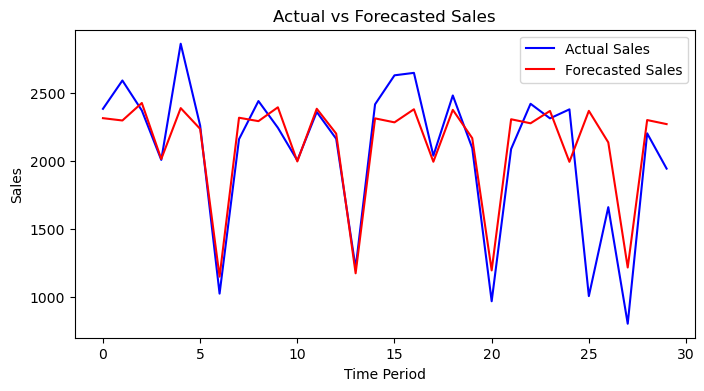

In [119]:
# R2 Score
R2_score_30days = r2_score(dfs_[1][0], forecast_arima_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][0].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_arima_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [120]:
evaluation_metrics(dfs_[1][0], forecast_arima_df)

{'MAE': 208.23055712140123,
 'MSE': 108649.93602840214,
 'MAPE': 13.510708689895608,
 'RMSE': 329.62089743886406,
 'R2 Score': 0.6197666032224782}

### Dairy

In [121]:
# Fitting SARIMA model
model_arima = ARIMA(dfs_[0][1], order=(Optimal_params_ARIMA[1][0], 1, Optimal_params_ARIMA[1][1]))
fit_model_arima = model_arima.fit()
# Forecasting Sales
forecast_arima = fit_model_arima.forecast(steps=len(dfs_[1][1]))
# Creating a dataframe for the forecasted values
forecast_arima_df =  forecast_arima.to_frame(name = 'Forecast')
forecast_arima_df.set_index(dfs_[1][1].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][1], forecast_arima_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_ARIMA[1][0],
      '\nq value - ',Optimal_params_ARIMA[1][1],
      '\nR2 score: ',R2_score,'\n')

p value -  13 
q value -  2 
R2 score:  0.5623615366821743 



R2 score of 30 days Forecasted Sales :  0.5623615366821743 



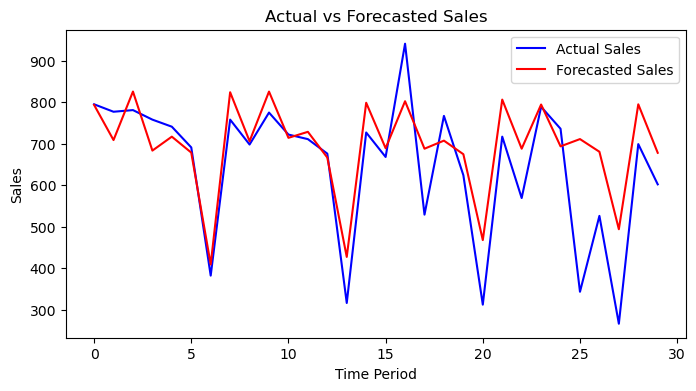

In [122]:
# R2 Score
R2_score_30days = r2_score(dfs_[1][1], forecast_arima_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][1].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_arima_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [123]:
evaluation_metrics(dfs_[1][1], forecast_arima_df)

{'MAE': 78.58659438020833,
 'MSE': 12135.298344998197,
 'MAPE': 16.8380486399624,
 'RMSE': 110.1603301783278,
 'R2 Score': 0.5623615366821743}

### Grocery

In [124]:
# Fitting SARIMA model
model_arima = ARIMA(dfs_[0][2], order=(Optimal_params_ARIMA[2][0], 1, Optimal_params_ARIMA[2][1]))
fit_model_arima = model_arima.fit()
# Forecasting Sales
forecast_arima = fit_model_arima.forecast(steps=len(dfs_[1][2]))
# Creating a dataframe for the forecasted values
forecast_arima_df =  forecast_arima.to_frame(name = 'Forecast')
forecast_arima_df.set_index(dfs_[1][2].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][2], forecast_arima_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_ARIMA[2][0],
      '\nq value - ',Optimal_params_ARIMA[2][1],
      '\nR2 score: ',R2_score,'\n')

p value -  14 
q value -  7 
R2 score:  0.6567015193639596 



R2 score of 30 days Forecasted Sales :  0.6567015193639596 



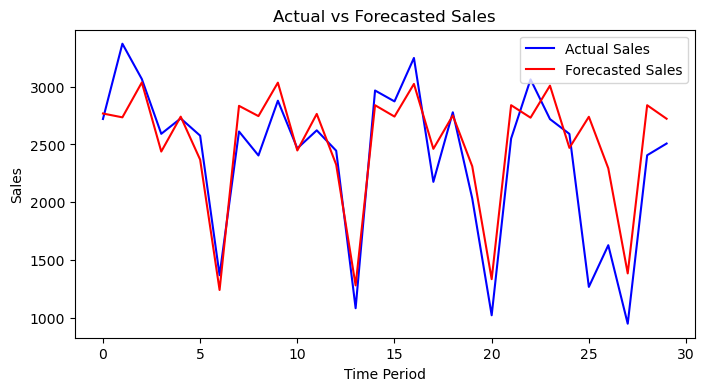

In [125]:
# R2 Score
R2_score_30days = r2_score(dfs_[1][2], forecast_arima_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][2].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_arima_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [126]:
evaluation_metrics(dfs_[1][2], forecast_arima_df)

{'MAE': 267.8576843476239,
 'MSE': 146775.26701733898,
 'MAPE': 14.74682391227705,
 'RMSE': 383.1126035741176,
 'R2 Score': 0.6567015193639596}

## ARIMA with External Features

In [127]:
# List to store parameters and R2 score
ARIMA_ext_optimal_parms_r2_list = []
for l in range(len(dfs_[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    ARIMA_ext_optimal_params_dict = {}
    for p in range(15):
        for q in range(15):
            # Fitting SARIMA model
            model_arima_ext = ARIMA(dfs_[0][l], exog=dfs_external_[0][l], order=(p, 1, q))
            fit_model_arima_ext = model_arima_ext.fit()
            # Forecasting Sales
            forecast_arima_ext = fit_model_arima_ext.forecast(steps=len(dfs_[1][l]), exog=dfs_external_[1][l])
            # Creating a dataframe for the forecasted values
            forecast_arima_ext_df =  forecast_arima_ext.to_frame(name = 'Forecast')
            forecast_arima_ext_df.set_index(dfs_[1][l].index, inplace = True)
            # R2 Score
            R2_score = r2_score(dfs_[1][l], forecast_arima_ext_df['Forecast'])
            # Appending to dict
            ARIMA_ext_optimal_params_dict[p,q] = R2_score
            # Printing R2 score and parameters
            print('p value - ',p,
                  '\nq value - ',q,
                  '\nR2 score: ',R2_score,'\n')
    optimal_params = max(ARIMA_ext_optimal_params_dict, key=ARIMA_ext_optimal_params_dict.get)
    print(f"{categories[l]} data optimal values for params p and q are : ",optimal_params)
    print("Maximum R2 Score is : ", ARIMA_ext_optimal_params_dict[optimal_params], '\n\n')
    ARIMA_ext_optimal_parms_r2_list.append(ARIMA_ext_optimal_params_dict)

# Print optimal values of parameters p and q
d=0
Optimal_params_ARIMA_ext = []
for i in ARIMA_ext_optimal_parms_r2_list:
    ARIMA_ext_optimal_params = max(i, key=i.get)
    Optimal_params_ARIMA_ext.append(ARIMA_ext_optimal_params)
    print(f"The optimal values for parameters p and q of {categories[d]} data: ", ARIMA_ext_optimal_params)
    print(f"Maximum R2 Score for {categories[d]} data is : ", i[ARIMA_ext_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

p value -  0 
q value -  0 
R2 score:  -9.574095459463434 

p value -  0 
q value -  1 
R2 score:  -0.07420620797743815 

p value -  0 
q value -  2 
R2 score:  -0.06371485538527 

p value -  0 
q value -  3 
R2 score:  -0.04763992227112168 

p value -  0 
q value -  4 
R2 score:  -0.17582086121393337 

p value -  0 
q value -  5 
R2 score:  0.01966741038776898 

p value -  0 
q value -  6 
R2 score:  -0.08346232451731894 

p value -  0 
q value -  7 
R2 score:  -0.43469634648433386 

p value -  0 
q value -  8 
R2 score:  0.258140086826109 

p value -  0 
q value -  9 
R2 score:  0.23658780276040825 

p value -  0 
q value -  10 
R2 score:  0.2384238738578146 

p value -  0 
q value -  11 
R2 score:  0.2353715914649499 

p value -  0 
q value -  12 
R2 score:  0.06487754262262002 

p value -  0 
q value -  13 
R2 score:  0.09714196095587313 

p value -  0 
q value -  14 
R2 score:  -0.19386132307731918 

p value -  1 
q 

## Optimal Model

### Beverages

In [128]:
# Fitting SARIMA model
model_arima_ext = ARIMA(dfs_[0][0], exog=dfs_external_[0][0], order=(Optimal_params_ARIMA_ext[0][0], 1,
                                                                     Optimal_params_ARIMA_ext[0][1]))
fit_model_arima_ext = model_arima_ext.fit()
# Forecasting Sales
forecast_arima_ext = fit_model_arima_ext.forecast(steps=len(dfs_[1][0]), exog=dfs_external_[1][0])
# Creating a dataframe for the forecasted values
forecast_arima_ext_df =  forecast_arima_ext.to_frame(name = 'Forecast')
forecast_arima_ext_df.set_index(dfs_[1][0].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][0], forecast_arima_ext_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_ARIMA_ext[0][0],
      '\nq value - ',Optimal_params_ARIMA_ext[0][1],
      '\nR2 score: ',R2_score,'\n')

p value -  14 
q value -  0 
R2 score:  0.6233629336266722 



R2 score of 30 days Forecasted Sales :  0.6233629336266722 



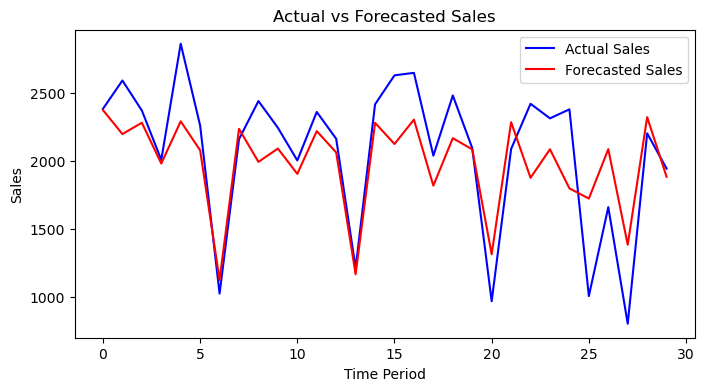

In [129]:
# R2 Score
R2_score_30days = r2_score(dfs_[1][0], forecast_arima_ext_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
#plt.plot(beverages_store1_train, label = 'Actual Sales(Train)')
plt.plot(dfs_[1][0].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_arima_ext_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [130]:
evaluation_metrics(dfs_[1][0], forecast_arima_ext_df)

{'MAE': 258.4146328776612,
 'MSE': 107622.30123444613,
 'MAPE': 14.918090643715995,
 'RMSE': 328.0583808325069,
 'R2 Score': 0.6233629336266722}

### Dairy

In [131]:
# Fitting SARIMA model
model_arima_ext = ARIMA(dfs_[0][1], exog=dfs_external_[0][1], order=(Optimal_params_ARIMA_ext[1][0], 1,
                                                                     Optimal_params_ARIMA_ext[1][1]))
fit_model_arima_ext = model_arima_ext.fit()
# Forecasting Sales
forecast_arima_ext = fit_model_arima_ext.forecast(steps=len(dfs_[1][1]), exog=dfs_external_[1][1])
# Creating a dataframe for the forecasted values
forecast_arima_ext_df =  forecast_arima_ext.to_frame(name = 'Forecast')
forecast_arima_ext_df.set_index(dfs_[1][1].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][1], forecast_arima_ext_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_ARIMA_ext[1][0],
      '\nq value - ',Optimal_params_ARIMA_ext[1][1],
      '\nR2 score: ',R2_score,'\n')

p value -  13 
q value -  1 
R2 score:  0.6139484031271983 



R2 score of 30 days Forecasted Sales :  0.6139484031271983 



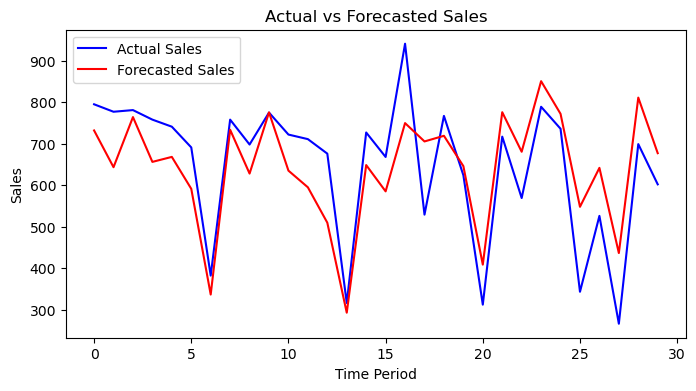

In [132]:
# R2 Score
R2_score_30days = r2_score(dfs_[1][1], forecast_arima_ext_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][1].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_arima_ext_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [133]:
evaluation_metrics(dfs_[1][1], forecast_arima_ext_df)

{'MAE': 88.78709982071184,
 'MSE': 10704.843603319543,
 'MAPE': 16.103357859040102,
 'RMSE': 103.46421411927673,
 'R2 Score': 0.6139484031271983}

### Grocery

In [134]:
# Fitting SARIMA model
model_arima_ext = ARIMA(dfs_[0][2], exog=dfs_external_[0][2], order=(Optimal_params_ARIMA_ext[2][0], 1,
                                                                     Optimal_params_ARIMA_ext[2][1]))
fit_model_arima_ext = model_arima_ext.fit()
# Forecasting Sales
forecast_arima_ext = fit_model_arima_ext.forecast(steps=len(dfs_[1][2]), exog=dfs_external_[1][2])
# Creating a dataframe for the forecasted values
forecast_arima_ext_df =  forecast_arima_ext.to_frame(name = 'Forecast')
forecast_arima_ext_df.set_index(dfs_[1][2].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][2], forecast_arima_ext_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_ARIMA_ext[2][0],
      '\nq value - ',Optimal_params_ARIMA_ext[2][1],
      '\nR2 score: ',R2_score,'\n')

p value -  13 
q value -  14 
R2 score:  0.8142115888829256 



R2 score of 30 days Forecasted Sales :  0.8142115888829256 



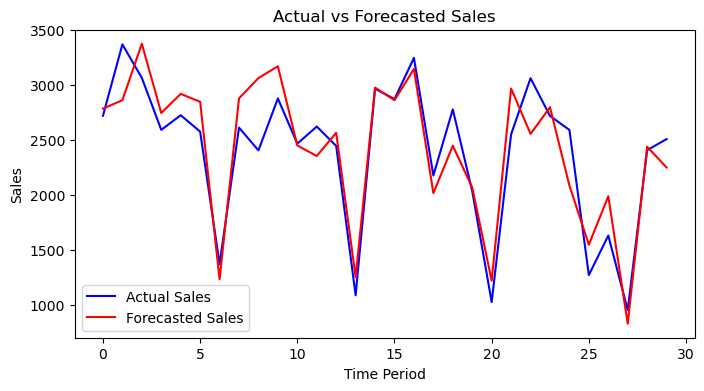

In [135]:
# R2 Score
R2_score_30days = r2_score(dfs_[1][2], forecast_arima_ext_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][2].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_arima_ext_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [136]:
evaluation_metrics(dfs_[1][2], forecast_arima_ext_df)

{'MAE': 227.62009887105694,
 'MSE': 79432.75367812088,
 'MAPE': 10.252184685912775,
 'RMSE': 281.8381693066446,
 'R2 Score': 0.8142115888829256}

## SARIMA Without External Features

In [137]:
# Ignoring all warnings, including ValueWarning and FutureWarning
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=ValueWarning)

## Parameter Tuning

In [138]:
# List to store parameters and R2 score
SARIMA_optimal_parms_r2_list = []
for l in range(len(dfs_[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    SARIMA_optimal_params_dict = {}
    for p in range(4):
        for q in range(3):
            for ss in range(1,5):
                s = ss*7
                # Fitting SARIMA model
                model_sarima = SARIMAX(dfs_[0][l], order=(p, 1, q), seasonal_order=(p, 1, 0, s))
                fit_model_sarima = model_sarima.fit()
                # Forecasting Sales
                forecast_sarima = fit_model_sarima.forecast(steps=len(dfs_[1][l]))
                # Creating a dataframe for the forecasted values
                forecast_sarima_df =  forecast_sarima.to_frame(name = 'Forecast')
                forecast_sarima_df.set_index(dfs_[1][l].index, inplace = True)
                # R2 Score
                R2_score = r2_score(dfs_[1][l], forecast_sarima_df['Forecast'])
                # Appending to dict
                SARIMA_optimal_params_dict[p,q,s] = R2_score
                # Printing R2 score and parameters
                print('p value - ',p,
                      '\nq value - ',q,
                      '\ns value - ',s,
                      '\nR2 score: ',R2_score,'\n')
    optimal_params = max(SARIMA_optimal_params_dict, key=SARIMA_optimal_params_dict.get)
    print(f"{categories[l]} data optimal values for params p, q and s are : ",optimal_params)
    print("Maximum R2 Score is : ", SARIMA_optimal_params_dict[optimal_params], '\n\n')
    SARIMA_optimal_parms_r2_list.append(SARIMA_optimal_params_dict)


# Print optimal values of parameters p,q and m
d=0
Optimal_params_SARIMA = []
for i in SARIMA_optimal_parms_r2_list:
    SARIMA_optimal_params = max(i, key=i.get)
    Optimal_params_SARIMA.append(SARIMA_optimal_params)
    print(f"The optimal values for parameters p, q and s of {categories[d]} data: ", SARIMA_optimal_params)
    print(f"Maximum R2 Score for {categories[d]} data is : ", i[SARIMA_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

p value -  0 
q value -  0 
s value -  7 
R2 score:  0.5750474292690126 

p value -  0 
q value -  0 
s value -  14 
R2 score:  0.6283760257252493 

p value -  0 
q value -  0 
s value -  21 
R2 score:  0.4208371780376142 

p value -  0 
q value -  0 
s value -  28 
R2 score:  0.2474992917256903 

p value -  0 
q value -  1 
s value -  7 
R2 score:  0.5289484825188802 

p value -  0 
q value -  1 
s value -  14 
R2 score:  0.6328970489610559 

p value -  0 
q value -  1 
s value -  21 
R2 score:  0.5163457488921268 

p value -  0 
q value -  1 
s value -  28 
R2 score:  0.5130862543741207 

p value -  0 
q value -  2 
s value -  7 
R2 score:  0.5755200702197212 

p value -  0 
q value -  2 
s value -  14 
R2 score:  0.5963823473378357 

p value -  0 
q value -  2 
s value -  21 
R2 score:  0.5160258083313756 

p value -  0 
q value -  2 
s value -  28 
R2 score:  0.509769617922631 

p value -  1 
q value -  0 
s value -  

## Optimal Model

### Beverages

In [139]:
# Fitting SARIMA model
model_sarima = SARIMAX(dfs_[0][0], order=(Optimal_params_SARIMA[0][0], 1, Optimal_params_SARIMA[0][1]),
                       seasonal_order=(Optimal_params_SARIMA[0][0], 1, 0, Optimal_params_SARIMA[0][2]))
fit_model_sarima = model_sarima.fit()
# Forecasting Sales
forecast_sarima = fit_model_sarima.forecast(steps=len(dfs_[1][0]))
# Creating a dataframe for the forecasted values
forecast_sarima_df =  forecast_sarima.to_frame(name = 'Forecast')
forecast_sarima_df.set_index(dfs_[1][0].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][0], forecast_sarima_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_SARIMA[0][0],
      '\nq value - ',Optimal_params_SARIMA[0][1],
      '\ns value - ',Optimal_params_SARIMA[0][2],
      '\nR2 score: ',R2_score,'\n')

p value -  3 
q value -  0 
s value -  7 
R2 score:  0.6474515842402522 



R2 score of 30 days Forecasted Sales :  0.6474515842402522 



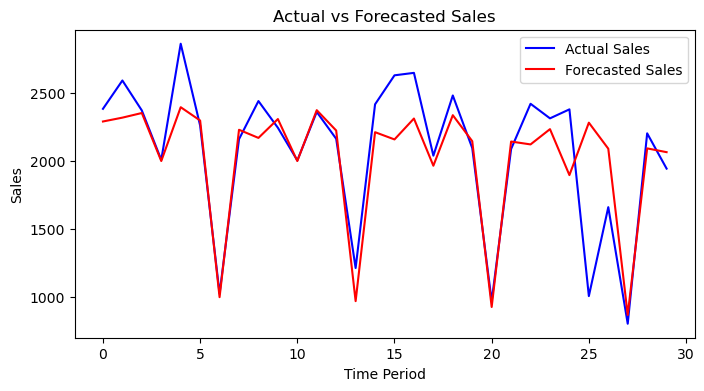

In [140]:
# R2 Score
R2_score_30days = r2_score(dfs_[1][0], forecast_sarima_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
#plt.plot(beverages_store1_train, label = 'Actual Sales(Train)')
plt.plot(dfs_[1][0].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_sarima_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [141]:
evaluation_metrics(dfs_[1][0], forecast_sarima_df)

{'MAE': 196.0605067237037,
 'MSE': 100739.08063794665,
 'MAPE': 11.419911511224564,
 'RMSE': 317.3942038505849,
 'R2 Score': 0.6474515842402522}

### Dairy

In [142]:
# Fitting SARIMA model
model_sarima = SARIMAX(dfs_[0][1], order=(Optimal_params_SARIMA[1][0], 1, Optimal_params_SARIMA[1][1]),
                       seasonal_order=(Optimal_params_SARIMA[1][0], 1, 0, Optimal_params_SARIMA[1][2]))
fit_model_sarima = model_sarima.fit()
# Forecasting Sales
forecast_sarima = fit_model_sarima.forecast(steps=len(dfs_[1][1]))
# Creating a dataframe for the forecasted values
forecast_sarima_df =  forecast_sarima.to_frame(name = 'Forecast')
forecast_sarima_df.set_index(dfs_[1][1].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][1], forecast_sarima_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_SARIMA[1][0],
      '\nq value - ',Optimal_params_SARIMA[1][1],
      '\ns value - ',Optimal_params_SARIMA[1][2],
      '\nR2 score: ',R2_score,'\n')

p value -  0 
q value -  1 
s value -  14 
R2 score:  0.7218191481084875 



R2 score of 30 days Forecasted Sales :  0.7218191481084875 



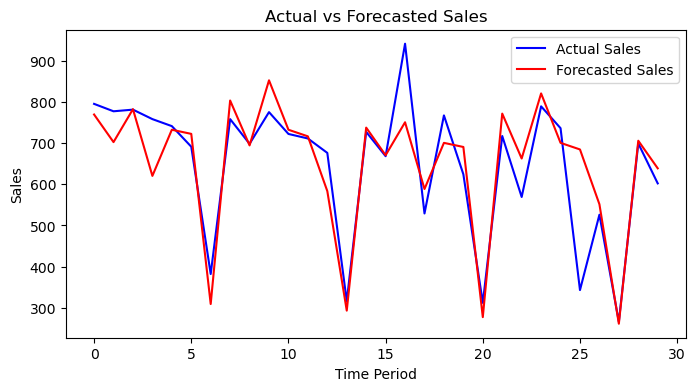

In [143]:
# R2 Score
R2_score_30days = r2_score(dfs_[1][1], forecast_sarima_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][1].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_sarima_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [144]:
evaluation_metrics(dfs_[1][1], forecast_sarima_df)

{'MAE': 55.6385184152077,
 'MSE': 7713.69044205251,
 'MAPE': 10.170535918574393,
 'RMSE': 87.82761776373368,
 'R2 Score': 0.7218191481084875}

### Grocery

In [145]:
# Fitting SARIMA model
model_sarima = SARIMAX(dfs_[0][2], order=(Optimal_params_SARIMA[2][0], 1, Optimal_params_SARIMA[2][1]),
                       seasonal_order=(Optimal_params_SARIMA[2][0], 1, 0, Optimal_params_SARIMA[2][2]))
fit_model_sarima = model_sarima.fit()
# Forecasting Sales
forecast_sarima = fit_model_sarima.forecast(steps=len(dfs_[1][2]))
# Creating a dataframe for the forecasted values
forecast_sarima_df =  forecast_sarima.to_frame(name = 'Forecast')
forecast_sarima_df.set_index(dfs_[1][2].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][2], forecast_sarima_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_SARIMA[2][0],
      '\nq value - ',Optimal_params_SARIMA[2][1],
      '\ns value - ',Optimal_params_SARIMA[2][2],
      '\nR2 score: ',R2_score,'\n')

p value -  3 
q value -  0 
s value -  7 
R2 score:  0.7082292398226562 



R2 score of 30 days Forecasted Sales :  0.7082292398226562 



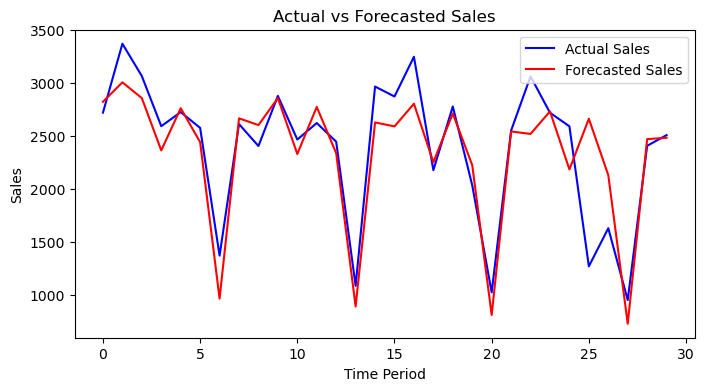

In [146]:
# R2 Score
R2_score_30days = r2_score(dfs_[1][2], forecast_sarima_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][2].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_sarima_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [147]:
evaluation_metrics(dfs_[1][2], forecast_sarima_df)

{'MAE': 237.59317437330708,
 'MSE': 124744.89008380935,
 'MAPE': 12.785615038175244,
 'RMSE': 353.1924264247598,
 'R2 Score': 0.7082292398226562}

## SARIMA with External Features

## Parameter Tuning

In [148]:
# List to store parameters and R2 score
SARIMA_ext_optimal_parms_r2_list = []
for l in range(len(dfs_[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    SARIMA_ext_optimal_params_dict = {}
    for p in range(4):
        for q in range(3):
            for ss in range(1,5):
                s = ss*7
                # Fitting SARIMA model
                model_sarima_ext = SARIMAX(dfs_[0][l], exog=dfs_external_[0][l], order=(p, 1, q), seasonal_order=(p, 1, 0, s))
                fit_model_sarima_ext = model_sarima_ext.fit()
                # Forecasting Sales
                forecast_sarima_ext = fit_model_sarima_ext.forecast(steps=len(dfs_[1][l]), exog=dfs_external_[1][l])
                # Creating a dataframe for the forecasted values
                forecast_sarima_ext_df =  forecast_sarima_ext.to_frame(name = 'Forecast')
                forecast_sarima_ext_df.set_index(dfs_[1][l].index, inplace = True)
                # R2 Score
                R2_score = r2_score(dfs_[1][l], forecast_sarima_ext_df['Forecast'])
                # Appending to dict
                SARIMA_ext_optimal_params_dict[p,q,s] = R2_score
                # Printing R2 score and parameters
                print('p value - ',p,
                      '\nq value - ',q,
                      '\ns value - ',s,
                      '\nR2 score: ',R2_score,'\n')
    optimal_params = max(SARIMA_ext_optimal_params_dict, key=SARIMA_ext_optimal_params_dict.get)
    print(f"{categories[l]} data optimal values for params p, q and s are : ",optimal_params)
    print("Maximum R2 Score is : ", SARIMA_ext_optimal_params_dict[optimal_params], '\n\n')
    SARIMA_ext_optimal_parms_r2_list.append(SARIMA_ext_optimal_params_dict)

# Print optimal values of parameters p,q and m
d=0
Optimal_params_SARIMA_ext = []
for i in SARIMA_ext_optimal_parms_r2_list:
    SARIMA_ext_optimal_params = max(i, key=i.get)
    Optimal_params_SARIMA_ext.append(SARIMA_ext_optimal_params)
    print(f"The optimal values for parameters p, q and s of {categories[d]} data: ", SARIMA_ext_optimal_params)
    print(f"Maximum R2 Score for {categories[d]} data is : ", i[SARIMA_ext_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

p value -  0 
q value -  0 
s value -  7 
R2 score:  0.3263072566590124 

p value -  0 
q value -  0 
s value -  14 
R2 score:  -0.10160210072617648 

p value -  0 
q value -  0 
s value -  21 
R2 score:  -0.043534778575973654 

p value -  0 
q value -  0 
s value -  28 
R2 score:  -0.7010624737060647 

p value -  0 
q value -  1 
s value -  7 
R2 score:  0.21409251326856815 

p value -  0 
q value -  1 
s value -  14 
R2 score:  -0.09251528744465953 

p value -  0 
q value -  1 
s value -  21 
R2 score:  0.20377146095891163 

p value -  0 
q value -  1 
s value -  28 
R2 score:  -0.28384698092305993 

p value -  0 
q value -  2 
s value -  7 
R2 score:  0.7809145139610987 

p value -  0 
q value -  2 
s value -  14 
R2 score:  0.19093408132681233 

p value -  0 
q value -  2 
s value -  21 
R2 score:  0.25754866327409054 

p value -  0 
q value -  2 
s value -  28 
R2 score:  -0.28886350091943824 

p value -  1 
q value 

## Optimal Model

### Beverages

In [149]:
# Fitting SARIMA model
model_sarima_ext = SARIMAX(dfs_[0][0], exog=dfs_external_[0][0], order=(Optimal_params_SARIMA_ext[0][0], 1, Optimal_params_SARIMA_ext[0][1]),
                           seasonal_order=(Optimal_params_SARIMA_ext[0][0], 1, 0, Optimal_params_SARIMA_ext[0][2]))
fit_model_sarima_ext = model_sarima_ext.fit()
# Forecasting Sales
forecast_sarima_ext = fit_model_sarima_ext.forecast(steps=len(dfs_[1][0]), exog=dfs_external_[1][0])
# Creating a dataframe for the forecasted values
forecast_sarima_ext_df =  forecast_sarima_ext.to_frame(name = 'Forecast')
forecast_sarima_ext_df.set_index(dfs_[1][0].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][0], forecast_sarima_ext_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_SARIMA_ext[0][0],
      '\nq value - ',Optimal_params_SARIMA_ext[0][1],
      '\ns value - ',Optimal_params_SARIMA_ext[0][2],
      '\nR2 score: ',R2_score,'\n')

p value -  1 
q value -  1 
s value -  7 
R2 score:  0.7847668768113142 



R2 score of 30 days Forecasted Sales :  0.7847668768113142 



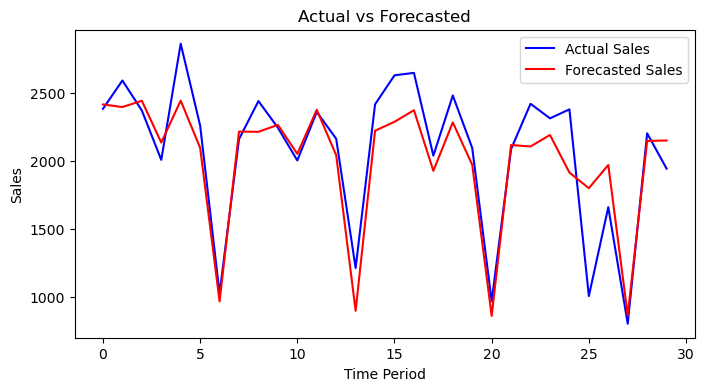

In [150]:
# 30 days Forecasted Sales
# R2 Score
R2_score_30days = r2_score(dfs_[1][0], forecast_sarima_ext_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][0].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_sarima_ext_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('SARIMA_Beverages.png', bbox_inches='tight')
plt.show()

In [151]:
evaluation_metrics(dfs_[1][0],forecast_sarima_ext_df['Forecast'])

{'MAE': 185.64125580275712,
 'MSE': 61501.87033498993,
 'MAPE': 10.407865569301736,
 'RMSE': 247.99570628337486,
 'R2 Score': 0.7847668768113142}

### Dairy

In [152]:
# Fitting SARIMA model
model_sarima_ext = SARIMAX(dfs_[0][1], exog=dfs_external_[0][1], order=(Optimal_params_SARIMA_ext[1][0], 1, Optimal_params_SARIMA_ext[1][1]),
                           seasonal_order=(Optimal_params_SARIMA_ext[1][0], 1, 0, Optimal_params_SARIMA_ext[1][2]))
fit_model_sarima_ext = model_sarima_ext.fit()
# Forecasting Sales
forecast_sarima_ext = fit_model_sarima_ext.forecast(steps=len(dfs_[1][1]), exog=dfs_external_[1][1])
# Creating a dataframe for the forecasted values
forecast_sarima_ext_df =  forecast_sarima_ext.to_frame(name = 'Forecast')
forecast_sarima_ext_df.set_index(dfs_[1][1].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][1], forecast_sarima_ext_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_SARIMA_ext[1][0],
      '\nq value - ',Optimal_params_SARIMA_ext[1][1],
      '\ns value - ',Optimal_params_SARIMA_ext[1][2],
      '\nR2 score: ',R2_score,'\n')

p value -  1 
q value -  1 
s value -  7 
R2 score:  0.7452938449949185 



R2 score of 30 days Forecasted Sales :  0.7452938449949185 



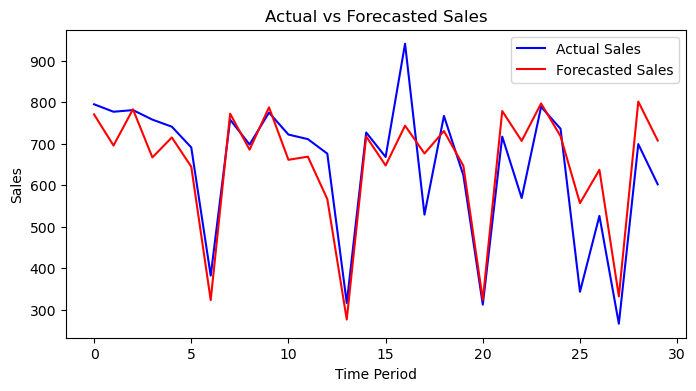

In [153]:
# 30 days Forecasted Sales
# R2 Score
R2_score_30days = r2_score(dfs_[1][1], forecast_sarima_ext_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][1].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_sarima_ext_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [154]:
evaluation_metrics(dfs_[1][1],forecast_sarima_ext_df['Forecast'])

{'MAE': 63.07293924071126,
 'MSE': 7062.7594244368165,
 'MAPE': 11.400663067529269,
 'RMSE': 84.04022503799484,
 'R2 Score': 0.7452938449949185}

### Grocery

In [155]:
# Fitting SARIMA model
model_sarima_ext = SARIMAX(dfs_[0][2], exog=dfs_external_[0][2], order=(Optimal_params_SARIMA_ext[2][0], 1, Optimal_params_SARIMA_ext[2][1]),
                           seasonal_order=(Optimal_params_SARIMA_ext[2][0], 1, 0, Optimal_params_SARIMA_ext[2][2]))
fit_model_sarima_ext = model_sarima_ext.fit()
# Forecasting Sales
forecast_sarima_ext = fit_model_sarima_ext.forecast(steps=len(dfs_[1][2]), exog=dfs_external_[1][2])
# Creating a dataframe for the forecasted values
forecast_sarima_ext_df =  forecast_sarima_ext.to_frame(name = 'Forecast')
forecast_sarima_ext_df.set_index(dfs_[1][2].index, inplace = True)
# R2 Score
R2_score = r2_score(dfs_[1][2], forecast_sarima_ext_df['Forecast'])
# Printing R2 score and parameters
print('p value - ',Optimal_params_SARIMA_ext[2][0],
      '\nq value - ',Optimal_params_SARIMA_ext[2][1],
      '\ns value - ',Optimal_params_SARIMA_ext[2][2],
      '\nR2 score: ',R2_score,'\n')

p value -  3 
q value -  0 
s value -  7 
R2 score:  0.8326637621540812 



R2 score of 30 days Forecasted Sales :  0.8326637621540812 



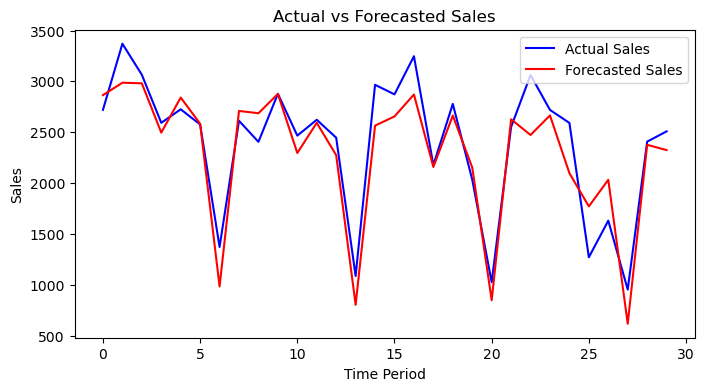

In [156]:
# 30 days Forecasted Sales
# R2 Score
R2_score_30days = r2_score(dfs_[1][2], forecast_sarima_ext_df)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual data and forecast
plt.figure(figsize=(8, 4))
plt.plot(dfs_[1][2].values, label = 'Actual Sales', color  = 'blue')
plt.plot(forecast_sarima_ext_df.values, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [157]:
evaluation_metrics(dfs_[1][2],forecast_sarima_ext_df['Forecast'])

{'MAE': 211.61750273585224,
 'MSE': 71543.63440818916,
 'MAPE': 10.827027954100691,
 'RMSE': 267.4764184151365,
 'R2 Score': 0.8326637621540812}

# Forecasting using ML Models

In [199]:
# Dataset
df_3_categories_ml.head()

,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,holiday,national_holiday,year,month,day,day_name
0,2013-01-01,1,BEVERAGES,0.0,0,18.0,12.0,3.0,13,93.31,1,1,0.0,1,1,5.0
1,2013-01-01,1,DAIRY,0.0,0,18.0,12.0,3.0,13,93.31,1,1,0.0,1,1,5.0
2,2013-01-01,1,GROCERY I,0.0,0,18.0,12.0,3.0,13,93.31,1,1,0.0,1,1,5.0
3,2013-01-02,1,BEVERAGES,1091.0,0,18.0,12.0,3.0,13,93.14,0,0,0.0,1,2,6.0
4,2013-01-02,1,DAIRY,579.0,0,18.0,12.0,3.0,13,93.14,0,0,0.0,1,2,6.0


### Set date as index

In [200]:
# Set 'date' column as index
df_3_categories_ml.set_index('date', inplace=True)
df_3_categories_ml.head()

,store_nbr,family,sales,onpromotion,city,state,type,cluster,dcoilwtico,holiday,national_holiday,year,month,day,day_name
date,,,,,,,,,,,,,,,
2013-01-01,1,BEVERAGES,0.0,0,18.0,12.0,3.0,13,93.31,1,1,0.0,1,1,5.0
2013-01-01,1,DAIRY,0.0,0,18.0,12.0,3.0,13,93.31,1,1,0.0,1,1,5.0
2013-01-01,1,GROCERY I,0.0,0,18.0,12.0,3.0,13,93.31,1,1,0.0,1,1,5.0
2013-01-02,1,BEVERAGES,1091.0,0,18.0,12.0,3.0,13,93.14,0,0,0.0,1,2,6.0
2013-01-02,1,DAIRY,579.0,0,18.0,12.0,3.0,13,93.14,0,0,0.0,1,2,6.0


### Number of days to Forecast

In [201]:
forecast_days = 30

### Filtering datasets based on Categories

In [202]:
df_beverages = df_3_categories_ml[df_3_categories_ml['family']=='BEVERAGES']
df_dairy = df_3_categories_ml[df_3_categories_ml['family']=='DAIRY']
df_grocery = df_3_categories_ml[df_3_categories_ml['family']=='GROCERY I']

### Function to split data

In [203]:
def train_test_split(df, forecast_days):
    train_len = len(df) - forecast_days + 1
    df_train = df[ : train_len]
    df_test = df[train_len-1 : ]
    return df_train, df_test

In [204]:
# Train and Test datasets
df_beverages_train, df_beverages_test = train_test_split(df_beverages, forecast_days)
df_dairy_train, df_dairy_test = train_test_split(df_dairy, forecast_days)
df_grocery_train, df_grocery_test = train_test_split(df_grocery, forecast_days)

### Function to Scale data

In [205]:
def scale_data(df1,df2,columns):
    # StandardScaler
    df1_copy = df1.copy()
    df2_copy = df2.copy()
    scaler = StandardScaler()
    df1_copy[columns] = scaler.fit_transform(df1_copy[columns])
    df2_copy[columns] = scaler.transform(df2_copy[columns])
    return df1_copy,df2_copy

In [206]:
# Scaling data
columns = ['sales', 'onpromotion', 'dcoilwtico', 'year', 'month', 'day', 'day_name']
# Train and Test datasets
df_beverages_scaled_train, df_beverages_scaled_test = scale_data(df_beverages_train, df_beverages_test, columns)
df_dairy_scaled_train, df_dairy_scaled_test = scale_data(df_dairy_train, df_dairy_test, columns)
df_grocery_scaled_train, df_grocery_scaled_test = scale_data(df_grocery_train, df_grocery_test, columns)

### Function to create lags

In [207]:
# Function to create lag features
def lag_features(df, lags):
    X = []
    y = np.array([])
    z = lags
    for k in range(len(df)-lags):
        X.append(list(df['sales'][k:z].values))
        y = np.append(y,df['sales'][z:z+1].values)
        z=z+1
    X = np.array(X)
    return X,y

### External Features

In [208]:
# Train data external features
df_beverages_scaled_train_external = df_beverages_scaled_train[:-1][['onpromotion', 'national_holiday', 'year', 'dcoilwtico', 'month']].values
df_dairy_scaled_train_external = df_dairy_scaled_train[:-1][['onpromotion', 'national_holiday', 'year', 'dcoilwtico', 'month']].values
df_grocery_scaled_train_external = df_grocery_scaled_train[:-1][['onpromotion', 'national_holiday', 'year', 'dcoilwtico', 'month']].values
df_beverages_scaled_train_external.shape

(1654, 5)

In [209]:
# Test data external features
df_beverages_scaled_test_external = df_beverages_scaled_test[['onpromotion', 'national_holiday', 'year', 'dcoilwtico', 'month']].values
df_dairy_scaled_test_external = df_dairy_scaled_test[['onpromotion', 'national_holiday', 'year', 'dcoilwtico', 'month']].values
df_grocery_scaled_test_external = df_grocery_scaled_test[['onpromotion', 'national_holiday', 'year', 'dcoilwtico', 'month']].values
df_beverages_scaled_test_external.shape

(30, 5)

### Dataframes

In [210]:
categories = ['BEVERAGES', 'DAIRY', 'GROCERY']
# Scaled dataframes
dfs_scaled = [[df_beverages_scaled_train,df_dairy_scaled_train,df_grocery_scaled_train],
        [df_beverages_scaled_test,df_dairy_scaled_test,df_grocery_scaled_test]]
dfs_external_scaled= [[df_beverages_scaled_train_external,df_dairy_scaled_train_external,df_grocery_scaled_train_external], 
                [df_beverages_scaled_test_external,df_dairy_scaled_test_external,df_grocery_scaled_test_external]]

In [211]:
cols = ['sales']
scaler_1 = StandardScaler()
df_beverages_train_ = df_beverages_train.copy()
df_beverages_test_ = df_beverages_test.copy()
df_beverages_train_[cols] = scaler_1.fit_transform(df_beverages_train_[cols])
df_beverages_test_[cols] = scaler_1.transform(df_beverages_test_[cols])

scaler_2 = StandardScaler()
df_dairy_train_ = df_dairy_train.copy()
df_dairy_test_ = df_dairy_test.copy()
df_dairy_train_[cols] = scaler_2.fit_transform(df_dairy_train_[cols])
df_dairy_test_[cols] = scaler_2.transform(df_dairy_test_[cols])

scaler_3 = StandardScaler()
df_grocery_train_ = df_grocery_train.copy()
df_grocery_test_ = df_grocery_test.copy()
df_grocery_train_[cols] = scaler_3.fit_transform(df_grocery_train_[cols])
df_grocery_test_[cols] = scaler_3.transform(df_grocery_test_[cols])

## Random Forest

### Parameter Tuning

In [184]:
# List to store parameters and R2 score
RF_optimal_parms_r2_list = []
for l in range(len(dfs_scaled[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    RF_optimal_parms_r2_dict = {}
    for i in [5,10,15,20,25,30,35,40,45,50,60,70,80,90,100]:
        for j in [1,2,3,4,5,6,7,8,9,10,12,14,16,18,20,22]:
            for k in range(1,22):
                # Train Test data
                X, y = lag_features(dfs_scaled[0][l],k)
                X_train = X[:-1 ]
                X_train = np.concatenate((X_train, dfs_external_scaled[0][l][k:]), axis=1)
                y_train = y[:-1]
                X_test = X[-1].reshape(1,-1)
                y_test = dfs_scaled[1][l]['sales'].values
                # Fitting Random Forest model
                model_RF = RandomForestRegressor(n_estimators = i, max_depth = j, random_state=42)
                model_RF.fit(X_train, y_train)
                # Forecasting Sales
                y_pred_RF = np.array([])
                c=0
                for m in range(forecast_days):
                    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][l][c].reshape(1,-1)), axis=1)
                    y_new = model_RF.predict(X_test_external)
                    # Roll the array to the left
                    X_test = np.roll(X_test, -1)
                    # Set the last element to the new value
                    X_test[0,-1] = y_new
                    c+=1
                    y_pred_RF = np.append(y_pred_RF,y_new)
                # R2 Score
                R2_score = r2_score(y_test, y_pred_RF)
                RF_optimal_parms_r2_dict[i,j,k] = R2_score
                # Print R2 score and params
                print('n_estimators - ',i,
                      '\nmax_depth - ',j,
                      '\nNo of lags - ',k,
                      '\nR2 score: ',R2_score,'\n')
    optimal_params = max(RF_optimal_parms_r2_dict, key=RF_optimal_parms_r2_dict.get)
    print(f"{categories[l]} data optimal values for params n_estimators, max_depth and lags are : ",optimal_params)
    print("Maximum R2 Score is : ", RF_optimal_parms_r2_dict[optimal_params], '\n\n')
    RF_optimal_parms_r2_list.append(RF_optimal_parms_r2_dict)

# Print optimal values of parameters n_estimators, max_depth and number_of_lags
d=0
Optimal_params_RF = []
for i in RF_optimal_parms_r2_list:
    RF_optimal_params = max(i, key=i.get)
    Optimal_params_RF.append(RF_optimal_params)
    print(f"The optimal values for parameters n_estimators, max_depth and lags of {categories[d]} data: ", RF_optimal_params)
    print(f"Maximum R2 Score for {categories[d]} data is : ", i[RF_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

n_estimators -  5 
max_depth -  1 
No of lags -  1 
R2 score:  -0.01816601675326579 

n_estimators -  5 
max_depth -  1 
No of lags -  2 
R2 score:  -0.031942630870855915 

n_estimators -  5 
max_depth -  1 
No of lags -  3 
R2 score:  -0.027286613195314224 

n_estimators -  5 
max_depth -  1 
No of lags -  4 
R2 score:  -0.03660424331316525 

n_estimators -  5 
max_depth -  1 
No of lags -  5 
R2 score:  -0.014554414536265048 

n_estimators -  5 
max_depth -  1 
No of lags -  6 
R2 score:  -0.004223831042155846 

n_estimators -  5 
max_depth -  1 
No of lags -  7 
R2 score:  0.5963468852460538 

n_estimators -  5 
max_depth -  1 
No of lags -  8 
R2 score:  0.5972149035008315 

n_estimators -  5 
max_depth -  1 
No of lags -  9 
R2 score:  0.5927218553269571 

n_estimators -  5 
max_depth -  1 
No of lags -  10 
R2 score:  0.5928502464145001 

n_estimators -  5 
max_depth -  1 
No of lags -  11 
R2 score:  0.595323095657

## Optimal Model

### Beverages

In [185]:
# Train Test data
X, y = lag_features(dfs_scaled[0][0],Optimal_params_RF[0][2])
X_train = X[:-1 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][0][Optimal_params_RF[0][2]:]), axis=1)
y_train = y[:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][0]['sales'].values
# Fitting Random Forest model
model_RF = RandomForestRegressor(n_estimators = Optimal_params_RF[0][0], max_depth = Optimal_params_RF[0][1], random_state=42)
model_RF.fit(X_train, y_train)
# Forecasting Sales
y_pred_RF = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][0][c].reshape(1,-1)), axis=1)
    y_new = model_RF.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    y_pred_RF = np.append(y_pred_RF,y_new)
    c+=1
# R2 Score
R2_score = r2_score(y_test, y_pred_RF)
# Print R2 score and optimal parameters
print('n_estimators - ',Optimal_params_RF[0][0],
      '\nmax_depth - ',Optimal_params_RF[0][1],
      '\nNo of lags - ',Optimal_params_RF[0][2],
      '\nR2 score: ',R2_score,'\n')

n_estimators -  15 
max_depth -  18 
No of lags -  11 
R2 score:  0.8293225724545306 



In [186]:
# Evaluation Metrics
y_test=scaler_1.inverse_transform(y_test.reshape(-1, 1))
y_pred_RF = scaler_1.inverse_transform(y_pred_RF.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_RF)

{'MAE': 174.43687971904637,
 'MSE': 48770.28620176105,
 'MAPE': 10.133203972311543,
 'RMSE': 220.8399560807805,
 'R2 Score': 0.8293225724545306}

R2 score of 30 days Forecasted Sales :  0.8293225724545306 



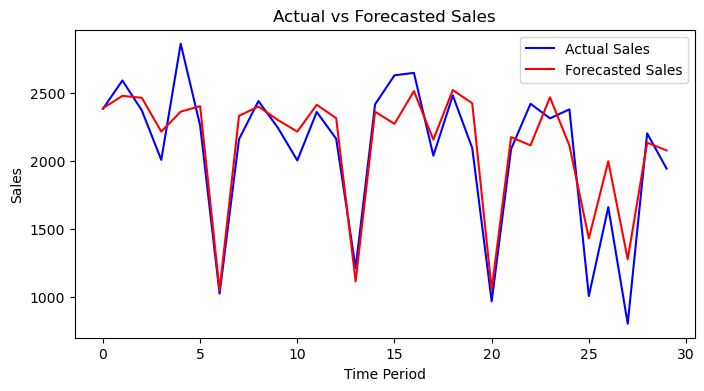

In [187]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_RF)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_RF, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('RF_Beverages.png', bbox_inches='tight')
plt.show()

### Dairy

In [188]:
# Train Test data
X, y = lag_features(dfs_scaled[0][1],Optimal_params_RF[1][2])
X_train = X[:-1 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][1][Optimal_params_RF[1][2]:]), axis=1)
y_train = y[:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][1]['sales'].values
# Fitting Random Forest model
model_RF = RandomForestRegressor(n_estimators = Optimal_params_RF[1][0], max_depth = Optimal_params_RF[1][1], random_state=42)
model_RF.fit(X_train, y_train)
# Forecasting Sales
y_pred_RF = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][1][c].reshape(1,-1)), axis=1)
    y_new = model_RF.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    y_pred_RF = np.append(y_pred_RF,y_new)
    c+=1
# R2 Score
R2_score = r2_score(y_test, y_pred_RF)
# Print R2 score and optimal parameters
print('n_estimators - ',Optimal_params_RF[1][0],
      '\nmax_depth - ',Optimal_params_RF[1][1],
      '\nNo of lags - ',Optimal_params_RF[1][2],
      '\nR2 score: ',R2_score,'\n')

n_estimators -  25 
max_depth -  20 
No of lags -  12 
R2 score:  0.7474426298428659 



In [189]:
# Evaluation Metrics
y_test=scaler_2.inverse_transform(y_test.reshape(-1, 1))
y_pred_RF = scaler_2.inverse_transform(y_pred_RF.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_RF)

{'MAE': 61.13007998305071,
 'MSE': 7003.175664336378,
 'MAPE': 11.23069067752053,
 'RMSE': 83.6849787257927,
 'R2 Score': 0.747442629842866}

R2 score of 30 days Forecasted Sales :  0.747442629842866 



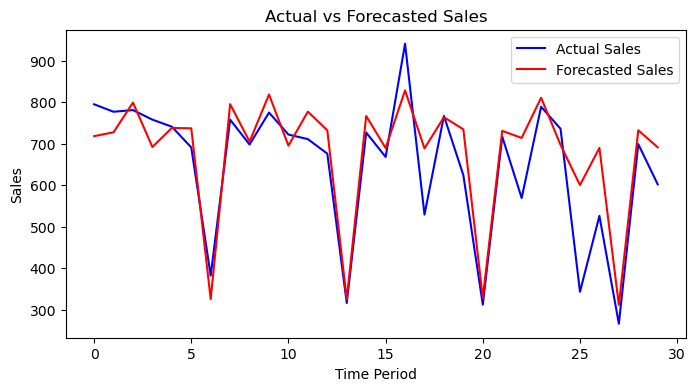

In [190]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_RF)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_RF, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('RF_Dairy.png', bbox_inches='tight')
plt.show()

### Grocery

In [191]:
# Train Test data
X, y = lag_features(dfs_scaled[0][2],Optimal_params_RF[2][2])
X_train = X[:-1 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][2][Optimal_params_RF[2][2]:]), axis=1)
y_train = y[:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][2]['sales'].values
# Fitting Random Forest model
model_RF = RandomForestRegressor(n_estimators = Optimal_params_RF[2][0], max_depth = Optimal_params_RF[2][1], random_state=42)
model_RF.fit(X_train, y_train)
# Forecasting Sales
y_pred_RF = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][2][c].reshape(1,-1)), axis=1)
    y_new = model_RF.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    y_pred_RF = np.append(y_pred_RF,y_new)
    c+=1
# R2 Score
R2_score = r2_score(y_test, y_pred_RF)
# Print R2 score and optimal parameters
print('n_estimators - ',Optimal_params_RF[2][0],
      '\nmax_depth - ',Optimal_params_RF[2][1],
      '\nNo of lags - ',Optimal_params_RF[2][2],
      '\nR2 score: ',R2_score,'\n')

n_estimators -  5 
max_depth -  10 
No of lags -  9 
R2 score:  0.8412088388584669 



In [192]:
# Evaluation Metrics
y_test=scaler_3.inverse_transform(y_test.reshape(-1, 1))
y_pred_RF = scaler_3.inverse_transform(y_pred_RF.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_RF)

{'MAE': 189.11285325861263,
 'MSE': 67890.23660507001,
 'MAPE': 8.3463643777402,
 'RMSE': 260.5575495069563,
 'R2 Score': 0.8412088388584669}

R2 score of 30 days Forecasted Sales :  0.8412088388584669 



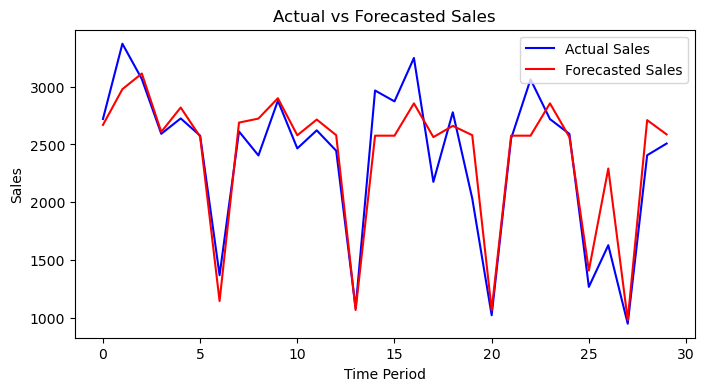

In [193]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_RF)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_RF, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('RF_Grocery.png', bbox_inches='tight')
plt.show()

## XGBoosting

### Parameter Tuning

In [19]:
# List to store parameters and R2 score
XGB_optimal_parms_r2_list = []
for l in range(len(dfs_scaled[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    XGB_optimal_parms_r2_dict = {}
    for n in [0.01,0.05,0.1,0.5]:
        for i in [5,10,15,20,25,30,40,50,60,70,80,90,100,110]:
            for j in [1,2,4,6,8,10,12,14,16,18,20,25,30]:
                for k in range(1,22):
                    # Train Test data
                    X, y = lag_features(dfs_scaled[0][l],k)
                    X_train = X[:-1 ]
                    X_train = np.concatenate((X_train, dfs_external_scaled[0][l][k:]), axis=1)
                    y_train = y[:-1]
                    X_test = X[-1].reshape(1,-1)
                    y_test = dfs_scaled[1][l]['sales'].values
                    # Fitting XGB model
                    model_XGB = XGBRegressor(n_estimators = i, max_depth = j, learning_rate = n, random_state=42)
                    model_XGB.fit(X_train, y_train)
                    # Forecasting Sales
                    y_pred_XGB = np.array([])
                    c=0
                    for m in range(forecast_days):
                        X_test_external = np.concatenate((X_test, dfs_external_scaled[1][l][c].reshape(1,-1)), axis=1)
                        y_new = model_XGB.predict(X_test_external)
                        # Roll the array to the left
                        X_test = np.roll(X_test, -1)
                        # Set the last element to the new value
                        X_test[0,-1] = y_new
                        c+=1
                        y_pred_XGB = np.append(y_pred_XGB,y_new)
                    # R2 Score
                    R2_score = r2_score(y_test, y_pred_XGB)
                    XGB_optimal_parms_r2_dict[i,j,k,n] = R2_score
                    # Print R2 score and params
                    print('n_estimators - ',i,
                          '\nmax_depth - ',j,
                          '\nNo of lags - ',k,
                          '\nLearning rate - ',n,
                          '\nR2 score: ',R2_score,'\n')
    optimal_params = max(XGB_optimal_parms_r2_dict, key=XGB_optimal_parms_r2_dict.get)
    print(f"{categories[l]} data optimal values for params n_estimators, max_depth, lags and learning_rate are : ",optimal_params)
    print("Maximum R2 Score is : ", XGB_optimal_parms_r2_dict[optimal_params], '\n\n')
    XGB_optimal_parms_r2_list.append(XGB_optimal_parms_r2_dict)

# Print optimal values of parameters n_estimators, max_depth, number_of_lags and learning_rate
d=1
Optimal_params_XGB = []
for i in XGB_optimal_parms_r2_list:
    XGB_optimal_params = max(i, key=i.get)
    Optimal_params_XGB.append(XGB_optimal_params)
    print(f"The optimal values for parameters n_estimators, max_depth, lags and learning_rate of {categories[l]} data: ", XGB_optimal_params)
    print(f"Maximum R2 Score for {categories[l]} data is : ", i[XGB_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

n_estimators -  5 
max_depth -  1 
No of lags -  1 
Learning rate -  0.01 
R2 score:  -0.77136139974936 

n_estimators -  5 
max_depth -  1 
No of lags -  2 
Learning rate -  0.01 
R2 score:  -0.7704367260215341 

n_estimators -  5 
max_depth -  1 
No of lags -  3 
Learning rate -  0.01 
R2 score:  -0.7691863344595236 

n_estimators -  5 
max_depth -  1 
No of lags -  4 
Learning rate -  0.01 
R2 score:  -0.7679997051221403 

n_estimators -  5 
max_depth -  1 
No of lags -  5 
Learning rate -  0.01 
R2 score:  -0.7672037480750002 

n_estimators -  5 
max_depth -  1 
No of lags -  6 
Learning rate -  0.01 
R2 score:  -0.7649845340442647 

n_estimators -  5 
max_depth -  1 
No of lags -  7 
Learning rate -  0.01 
R2 score:  -0.7366147113595334 

n_estimators -  5 
max_depth -  1 
No of lags -  8 
Learning rate -  0.01 
R2 score:  -0.7355790880535551 

n_estimators -  5 
max_depth -  1 
No of lags -  9 
Learning rate -  0.01

In [212]:
# List to store parameters and R2 score
XGB_optimal_parms_r2_list = []
for l in range(len(dfs_scaled[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    XGB_optimal_parms_r2_dict = {}
    for n in [0.01,0.05,0.1,0.5]:
        for i in [5,10,15,20,25,30,40,50,60,70,80,90,100,110]:
            for j in [1,2,4,6,8,10,12,14,16,18,20,25,30]:
                for k in range(1,22):
                    # Train Test data
                    X, y = lag_features(dfs_scaled[0][l],k)
                    X_train = X[:-1 ]
                    X_train = np.concatenate((X_train, dfs_external_scaled[0][l][k:]), axis=1)
                    y_train = y[:-1]
                    X_test = X[-1].reshape(1,-1)
                    y_test = dfs_scaled[1][l]['sales'].values
                    # Fitting XGB model
                    model_XGB = XGBRegressor(n_estimators = i, max_depth = j, learning_rate = n, random_state=42)
                    model_XGB.fit(X_train, y_train)
                    # Forecasting Sales
                    y_pred_XGB = np.array([])
                    c=0
                    for m in range(forecast_days):
                        X_test_external = np.concatenate((X_test, dfs_external_scaled[1][l][c].reshape(1,-1)), axis=1)
                        y_new = model_XGB.predict(X_test_external)
                        # Roll the array to the left
                        X_test = np.roll(X_test, -1)
                        # Set the last element to the new value
                        X_test[0,-1] = y_new
                        c+=1
                        y_pred_XGB = np.append(y_pred_XGB,y_new)
                    # R2 Score
                    R2_score = r2_score(y_test, y_pred_XGB)
                    XGB_optimal_parms_r2_dict[i,j,k,n] = R2_score
                    # Print R2 score and params
                    print('n_estimators - ',i,
                          '\nmax_depth - ',j,
                          '\nNo of lags - ',k,
                          '\nLearning rate - ',n,
                          '\nR2 score: ',R2_score,'\n')
    optimal_params = max(XGB_optimal_parms_r2_dict, key=XGB_optimal_parms_r2_dict.get)
    print(f"{categories[l]} data optimal values for params n_estimators, max_depth, lags and learning_rate are : ",optimal_params)
    print("Maximum R2 Score is : ", XGB_optimal_parms_r2_dict[optimal_params], '\n\n')
    XGB_optimal_parms_r2_list.append(XGB_optimal_parms_r2_dict)

# Print optimal values of parameters n_estimators, max_depth, number_of_lags and learning_rate
d=0
Optimal_params_XGB = []
for i in XGB_optimal_parms_r2_list:
    XGB_optimal_params = max(i, key=i.get)
    Optimal_params_XGB.append(XGB_optimal_params)
    print(f"The optimal values for parameters n_estimators, max_depth, lags and learning_rate of {categories[d]} data: ", XGB_optimal_params)
    print(f"Maximum R2 Score for {categories[d]} data is : ", i[XGB_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

n_estimators -  5 
max_depth -  1 
No of lags -  1 
Learning rate -  0.01 
R2 score:  -0.77136139974936 

n_estimators -  5 
max_depth -  1 
No of lags -  2 
Learning rate -  0.01 
R2 score:  -0.7704367260215341 

n_estimators -  5 
max_depth -  1 
No of lags -  3 
Learning rate -  0.01 
R2 score:  -0.7691863344595236 

n_estimators -  5 
max_depth -  1 
No of lags -  4 
Learning rate -  0.01 
R2 score:  -0.7679997051221403 

n_estimators -  5 
max_depth -  1 
No of lags -  5 
Learning rate -  0.01 
R2 score:  -0.7672037480750002 

n_estimators -  5 
max_depth -  1 
No of lags -  6 
Learning rate -  0.01 
R2 score:  -0.7649845340442647 

n_estimators -  5 
max_depth -  1 
No of lags -  7 
Learning rate -  0.01 
R2 score:  -0.7366147113595334 

n_estimators -  5 
max_depth -  1 
No of lags -  8 
Learning rate -  0.01 
R2 score:  -0.7355790880535551 

n_estimators -  5 
max_depth -  1 
No of lags -  9 
Learning rate -  0.01

## Optimal Model

### Beverages

In [213]:
# Train Test data
X, y = lag_features(dfs_scaled[0][0],Optimal_params_XGB[0][2])
X_train = X[:-1 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][0][Optimal_params_XGB[0][2]:]), axis=1)
y_train = y[:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][0]['sales'].values
# Fitting XGB model
model_XGB = XGBRegressor(n_estimators = Optimal_params_XGB[0][0], max_depth = Optimal_params_XGB[0][1], learning_rate = Optimal_params_XGB[0][3], random_state=42)
model_XGB.fit(X_train, y_train)
# Forecasting Sales
y_pred_XGB = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][0][c].reshape(1,-1)), axis=1)
    y_new = model_XGB.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    c+=1
    y_pred_XGB = np.append(y_pred_XGB,y_new)
# R2 Score
R2_score = r2_score(y_test, y_pred_XGB)
# Print R2 score and params
print('n_estimators - ',Optimal_params_XGB[0][0],
      '\nmax_depth - ',Optimal_params_XGB[0][1],
      '\nNo of lags - ',Optimal_params_XGB[0][2],
      '\nLearning rate - ',Optimal_params_XGB[0][3],
      '\nR2 score: ',R2_score,'\n')

n_estimators -  110 
max_depth -  4 
No of lags -  13 
Learning rate -  0.5 
R2 score:  0.8609077636087661 



In [214]:
# Evaluation Metrics
y_test=scaler_1.inverse_transform(y_test.reshape(-1, 1))
y_pred_XGB = scaler_1.inverse_transform(y_pred_XGB.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_XGB)

{'MAE': 157.95312839776676,
 'MSE': 39744.963788116016,
 'MAPE': 8.39634101002109,
 'RMSE': 199.3613899131826,
 'R2 Score': 0.8609077636087661}

R2 score of 30 days Forecasted Sales :  0.8609077636087661 



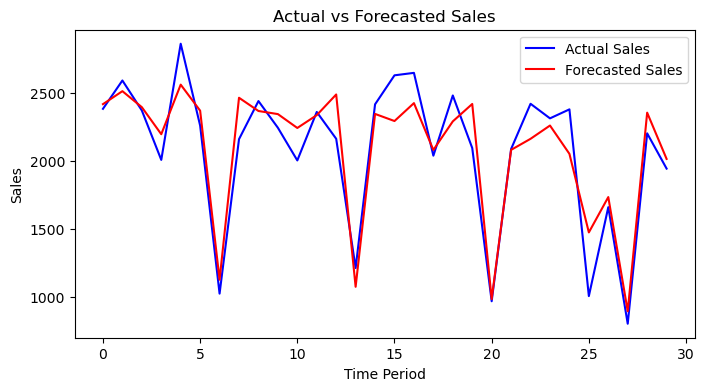

In [215]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_XGB)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_XGB, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('XGB_Beverages.png', bbox_inches='tight')
plt.show()

### Dairy

In [216]:
# Train Test data
X, y = lag_features(dfs_scaled[0][1],Optimal_params_XGB[1][2])
X_train = X[:-1 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][1][Optimal_params_XGB[1][2]:]), axis=1)
y_train = y[:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][1]['sales'].values
# Fitting XGB model
model_XGB = XGBRegressor(n_estimators = Optimal_params_XGB[1][0], max_depth = Optimal_params_XGB[1][1], learning_rate = Optimal_params_XGB[1][3], random_state=42)
model_XGB.fit(X_train, y_train)
# Forecasting Sales
y_pred_XGB = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][1][c].reshape(1,-1)), axis=1)
    y_new = model_XGB.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    c+=1
    y_pred_XGB = np.append(y_pred_XGB,y_new)
# R2 Score
R2_score = r2_score(y_test, y_pred_XGB)
# Print R2 score and params
print('n_estimators - ',Optimal_params_XGB[1][0],
      '\nmax_depth - ',Optimal_params_XGB[1][1],
      '\nNo of lags - ',Optimal_params_XGB[1][2],
      '\nLearning rate - ',Optimal_params_XGB[1][3],
      '\nR2 score: ',R2_score,'\n')

n_estimators -  60 
max_depth -  12 
No of lags -  9 
Learning rate -  0.05 
R2 score:  0.8199625292214109 



In [217]:
# Evaluation Metrics
y_test=scaler_2.inverse_transform(y_test.reshape(-1, 1))
y_pred_XGB = scaler_2.inverse_transform(y_pred_XGB.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_XGB)

{'MAE': 56.81770217732303,
 'MSE': 4992.267829051402,
 'MAPE': 9.896350108228493,
 'RMSE': 70.6559822594761,
 'R2 Score': 0.8199625292214109}

R2 score of 30 days Forecasted Sales :  0.8199625292214109 



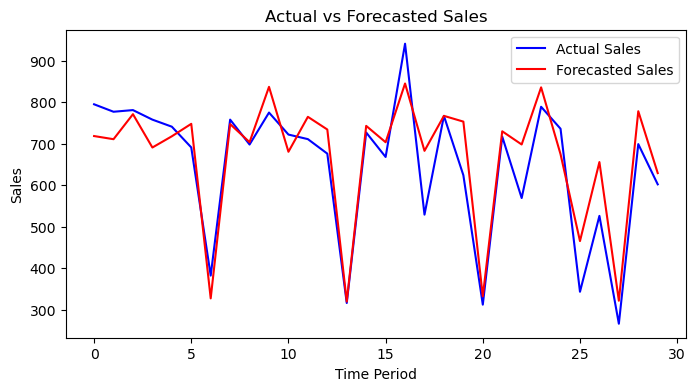

In [218]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_XGB)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_XGB, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('XGB_Dairy.png', bbox_inches='tight')
plt.show()

### Grocery

In [219]:
# Train Test data
X, y = lag_features(dfs_scaled[0][2],Optimal_params_XGB[2][2])
X_train = X[:-1 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][2][Optimal_params_XGB[2][2]:]), axis=1)
y_train = y[:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][2]['sales'].values
# Fitting XGB model
model_XGB = XGBRegressor(n_estimators = Optimal_params_XGB[2][0], max_depth = Optimal_params_XGB[2][1], learning_rate = Optimal_params_XGB[2][3], random_state=42)
model_XGB.fit(X_train, y_train)
# Forecasting Sales
y_pred_XGB = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][2][c].reshape(1,-1)), axis=1)
    y_new = model_XGB.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    c+=1
    y_pred_XGB = np.append(y_pred_XGB,y_new)
# R2 Score
R2_score = r2_score(y_test, y_pred_XGB)
# Print R2 score and params
print('n_estimators - ',Optimal_params_XGB[2][0],
      '\nmax_depth - ',Optimal_params_XGB[2][1],
      '\nNo of lags - ',Optimal_params_XGB[2][2],
      '\nLearning rate - ',Optimal_params_XGB[2][3],
      '\nR2 score: ',R2_score,'\n')

n_estimators -  60 
max_depth -  14 
No of lags -  8 
Learning rate -  0.05 
R2 score:  0.8258173010521944 



In [220]:
# Evaluation Metrics
y_test=scaler_3.inverse_transform(y_test.reshape(-1, 1))
y_pred_XGB = scaler_3.inverse_transform(y_pred_XGB.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_XGB)

{'MAE': 209.36692119682013,
 'MSE': 74470.79899829006,
 'MAPE': 9.28629722039279,
 'RMSE': 272.8933839401206,
 'R2 Score': 0.8258173010521944}

R2 score of 30 days Forecasted Sales :  0.8258173010521944 



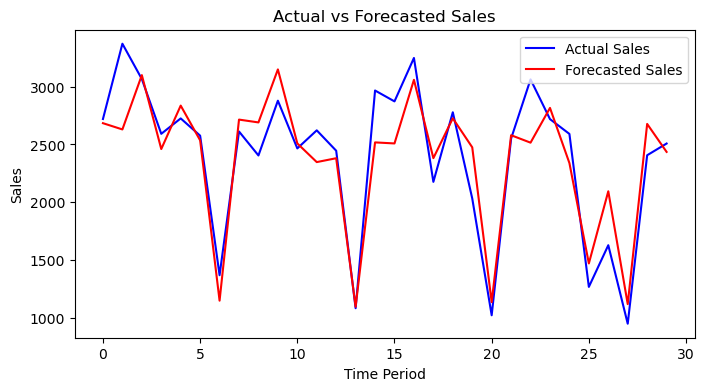

In [221]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_XGB)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_XGB, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('XGB_Grocery.png', bbox_inches='tight')
plt.show()

## SVM

### Parameter tuning

In [22]:
# List to store parameters and R2 score
SVM_optimal_parms_r2_list = []
for l in range(len(dfs_scaled[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    SVM_optimal_parms_r2_dict = {}
    for i in [0.1,0.5,1,2,3,5,10,15,20,30,40,50,100,200,500]:
        for j in [0.001,0.005,0.01,0.05,0.1,0.5,1]:
            for k in range(1,22):
                # Train Test data
                X, y = lag_features(dfs_scaled[0][l],k)
                X_train = X[:-1 ]
                X_train = np.concatenate((X_train, dfs_external_scaled[0][l][k:]), axis=1)
                y_train = y[:-1]
                X_test = X[-1].reshape(1,-1)
                y_test = dfs_scaled[1][l]['sales'].values
                # Fitting SVM model
                model_svm = SVR(C=i, epsilon=j)
                model_svm.fit(X_train, y_train)
                # Forecasting Sales
                y_pred_SVM = np.array([])
                c=0
                for m in range(forecast_days):
                    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][l][c].reshape(1,-1)), axis=1)
                    y_new = model_svm.predict(X_test_external)
                    # Roll the array to the left
                    X_test = np.roll(X_test, -1)
                    # Set the last element to the new value
                    X_test[0,-1] = y_new
                    c+=1
                    y_pred_SVM = np.append(y_pred_SVM,y_new)
                # R2 Score
                R2_score = r2_score(y_test, y_pred_SVM)
                SVM_optimal_parms_r2_dict[i,j,k] = R2_score
                # Print R2 score and parameters
                print('C - ',i,
                      '\nepsilon - ',j,
                      '\nNo of lags - ',k,
                      '\nR2 score: ',R2_score,'\n')
    optimal_params = max(SVM_optimal_parms_r2_dict, key=SVM_optimal_parms_r2_dict.get)
    print(f"{categories[l]} data optimal values for params C, epsilon, and lags are : ",optimal_params)
    print("Maximum R2 Score is : ", SVM_optimal_parms_r2_dict[optimal_params], '\n\n')
    SVM_optimal_parms_r2_list.append(SVM_optimal_parms_r2_dict)
    
# Print optimal values of parameters C, epsilon and number_of_lags
d=0
Optimal_params_SVM = []
for i in SVM_optimal_parms_r2_list:
    SVM_optimal_params = max(i, key=i.get)
    Optimal_params_SVM.append(SVM_optimal_params)
    print(f"The optimal values for parameters C, epsilon and lags of {categories[d]} data: ", SVM_optimal_params)
    print(f"Maximum R2 Score for {categories[d]} data is : ", i[SVM_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

C -  0.1 
epsilon -  0.001 
No of lags -  1 
R2 score:  0.0783021504767708 

C -  0.1 
epsilon -  0.001 
No of lags -  2 
R2 score:  0.06662763479357192 

C -  0.1 
epsilon -  0.001 
No of lags -  3 
R2 score:  0.11411133276382412 

C -  0.1 
epsilon -  0.001 
No of lags -  4 
R2 score:  0.08357180881405724 

C -  0.1 
epsilon -  0.001 
No of lags -  5 
R2 score:  0.13613456086665687 

C -  0.1 
epsilon -  0.001 
No of lags -  6 
R2 score:  0.17786478041851128 

C -  0.1 
epsilon -  0.001 
No of lags -  7 
R2 score:  0.6385459684620816 

C -  0.1 
epsilon -  0.001 
No of lags -  8 
R2 score:  0.6667517393480478 

C -  0.1 
epsilon -  0.001 
No of lags -  9 
R2 score:  0.6561340583788351 

C -  0.1 
epsilon -  0.001 
No of lags -  10 
R2 score:  0.6555258413293243 

C -  0.1 
epsilon -  0.001 
No of lags -  11 
R2 score:  0.6486514591771013 

C -  0.1 
epsilon -  0.001 
No of lags -  12 
R2 score:  0.6516662572764613 

C -

## Optimal Model

### Beverages

In [210]:
# Train Test data
X, y = lag_features(dfs_scaled[0][0],Optimal_params_SVM[0][2])
X_train = X[:-1 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][0][Optimal_params_SVM[0][2]:]), axis=1)
y_train = y[:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][0]['sales'].values
# Fitting SVM model
model_svm = SVR(C=Optimal_params_SVM[0][0], epsilon=Optimal_params_SVM[0][1])
model_svm.fit(X_train, y_train)
# Forecasting Sales
y_pred_SVM = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][0][c].reshape(1,-1)), axis=1)
    y_new = model_svm.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    c+=1
    y_pred_SVM = np.append(y_pred_SVM,y_new)
# R2 Score
R2_score = r2_score(y_test, y_pred_SVM)
# Print R2 score and parameters
print('C - ',Optimal_params_SVM[0][0],
      '\nepsilon - ',Optimal_params_SVM[0][1],
      '\nNo of lags - ',Optimal_params_SVM[0][2],
      '\nR2 score: ',R2_score,'\n')

C -  10 
epsilon -  0.1 
No of lags -  8 
R2 score:  0.8537040506384677 



In [211]:
# Evaluation Metrics
y_test=scaler_1.inverse_transform(y_test.reshape(-1, 1))
y_pred_SVM = scaler_1.inverse_transform(y_pred_SVM.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_SVM)

{'MAE': 175.16276937813078,
 'MSE': 41803.39148022076,
 'MAPE': 9.105179879911885,
 'RMSE': 204.45877697037307,
 'R2 Score': 0.8537040506384677}

R2 score of 30 days Forecasted Sales :  0.8537040506384677 



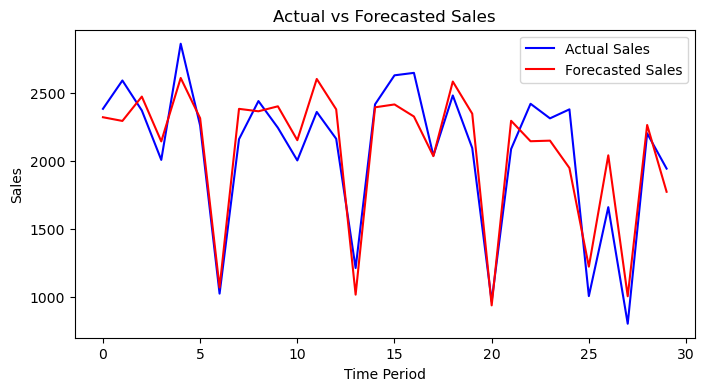

In [212]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_SVM)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_SVM, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('SVM_Beverages.png', bbox_inches='tight')
plt.show()

### Dairy

In [213]:
# Train Test data
X, y = lag_features(dfs_scaled[0][1],Optimal_params_SVM[1][2])
X_train = X[:-1 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][1][Optimal_params_SVM[1][2]:]), axis=1)
y_train = y[:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][1]['sales'].values
# Fitting SVM model
model_svm = SVR(C=Optimal_params_SVM[1][0], epsilon=Optimal_params_SVM[1][1])
model_svm.fit(X_train, y_train)
# Forecasting Sales
y_pred_SVM = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][1][c].reshape(1,-1)), axis=1)
    y_new = model_svm.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    c+=1
    y_pred_SVM = np.append(y_pred_SVM,y_new)
# R2 Score
R2_score = r2_score(y_test, y_pred_SVM)
# Print R2 score and parameters
print('C - ',Optimal_params_SVM[1][0],
      '\nepsilon - ',Optimal_params_SVM[1][1],
      '\nNo of lags - ',Optimal_params_SVM[1][2],
      '\nR2 score: ',R2_score,'\n')

C -  20 
epsilon -  0.1 
No of lags -  18 
R2 score:  0.8210558491233698 



In [214]:
# Evaluation Metrics
y_test=scaler_2.inverse_transform(y_test.reshape(-1, 1))
y_pred_SVM = scaler_2.inverse_transform(y_pred_SVM.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_SVM)

{'MAE': 53.551195237369946,
 'MSE': 4961.951108038788,
 'MAPE': 9.125503624476137,
 'RMSE': 70.44111802093141,
 'R2 Score': 0.8210558491233698}

R2 score of 30 days Forecasted Sales :  0.8210558491233698 



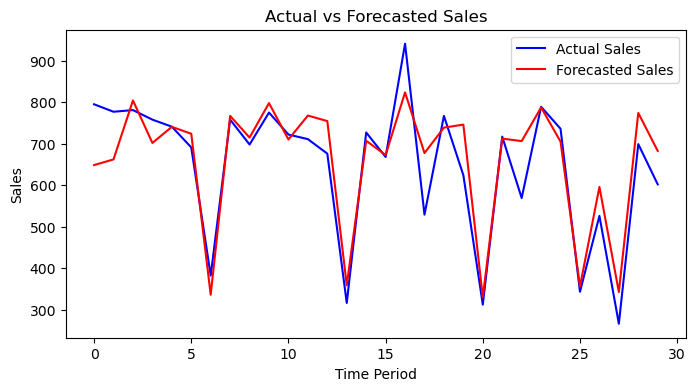

In [215]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_SVM)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_SVM, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('SVM_Dairy.png', bbox_inches='tight')
plt.show()

### Grocery

In [216]:
# Train Test data
X, y = lag_features(dfs_scaled[0][2],Optimal_params_SVM[2][2])
X_train = X[:-1 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][2][Optimal_params_SVM[2][2]:]), axis=1)
y_train = y[:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][2]['sales'].values
# Fitting SVM model
model_svm = SVR(C=Optimal_params_SVM[2][0], epsilon=Optimal_params_SVM[2][1])
model_svm.fit(X_train, y_train)
# Forecasting Sales
y_pred_SVM = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][2][c].reshape(1,-1)), axis=1)
    y_new = model_svm.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    c+=1
    y_pred_SVM = np.append(y_pred_SVM,y_new)
# R2 Score
R2_score = r2_score(y_test, y_pred_SVM)
# Print R2 score and parameters
print('C - ',Optimal_params_SVM[2][0],
      '\nepsilon - ',Optimal_params_SVM[2][1],
      '\nNo of lags - ',Optimal_params_SVM[2][2],
      '\nR2 score: ',R2_score,'\n')

C -  10 
epsilon -  0.001 
No of lags -  8 
R2 score:  0.8483896366057697 



In [217]:
# Evaluation Metrics
y_test=scaler_3.inverse_transform(y_test.reshape(-1, 1))
y_pred_SVM = scaler_3.inverse_transform(y_pred_SVM.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_SVM)

{'MAE': 203.56838281752945,
 'MSE': 64820.128328432234,
 'MAPE': 8.955487841296032,
 'RMSE': 254.59797392837248,
 'R2 Score': 0.8483896366057697}

R2 score of 30 days Forecasted Sales :  0.8483896366057697 



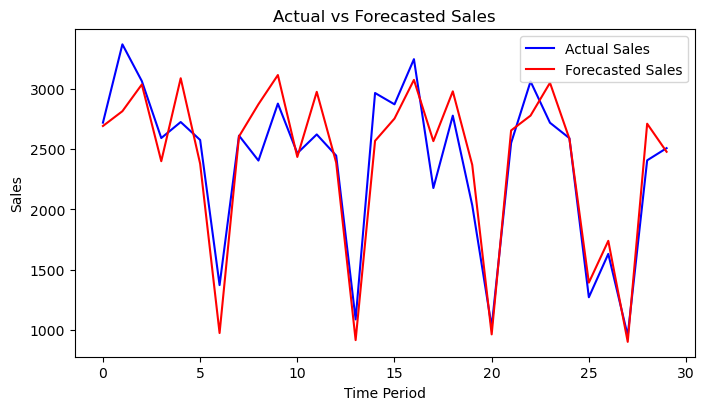

In [226]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_SVM)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4.25))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_SVM, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('SVM_Grocery.png', bbox_inches='tight')
plt.show()

## Facebook Prophet (FB Prophet)

In [254]:
df_beverages_fb = df_3_categories_fb[df_3_categories_fb['family']=='BEVERAGES']
df_beverages_fb = df_beverages_fb.reset_index(drop=True)
df_dairy_fb = df_3_categories_fb[df_3_categories_fb['family']=='DAIRY']
df_dairy_fb = df_dairy_fb.reset_index(drop=True)
df_grocery_fb = df_3_categories_fb[df_3_categories_fb['family']=='GROCERY I']
df_grocery_fb = df_grocery_fb.reset_index(drop=True)

In [255]:
train_cols = ['date', 'sales', 'onpromotion', 'dcoilwtico', 'year', 'month','national_holiday', 'day', 'day_name']
df_beverages_fb = df_beverages_fb[train_cols]
df_dairy_fb = df_dairy_fb[train_cols]
df_grocery_fb = df_grocery_fb[train_cols]

In [256]:
df_beverages_fb['date'] = pd.to_datetime(df_beverages_fb['date'])
df_beverages_fb.rename(columns={'date': 'ds', 'sales': 'y'}, inplace=True)
df_dairy_fb['date'] = pd.to_datetime(df_dairy_fb['date'])
df_dairy_fb.rename(columns={'date': 'ds', 'sales': 'y'}, inplace=True)
df_grocery_fb['date'] = pd.to_datetime(df_grocery_fb['date'])
df_grocery_fb.rename(columns={'date': 'ds', 'sales': 'y'}, inplace=True)

In [257]:
df_beverages_fb_train = df_beverages_fb[:-30]
df_beverages_fb_test = df_beverages_fb[-30:].drop('y', axis=1)
df_dairy_fb_train = df_dairy_fb[:-30]
df_dairy_fb_test = df_dairy_fb[-30:].drop('y', axis=1)
df_grocery_fb_train = df_grocery_fb[:-30]
df_grocery_fb_test = df_grocery_fb[-30:].drop('y', axis=1)

In [258]:
y_test_beverages_fb = df_beverages_fb['y'][-30:]
y_test_beverages_fb = y_test_beverages_fb.reset_index(drop=True)
y_test_dairy_fb = df_dairy_fb['y'][-30:]
y_test_dairy_fb = y_test_dairy_fb.reset_index(drop=True)
y_test_grocery_fb = df_grocery_fb['y'][-30:]
y_test_grocery_fb = y_test_grocery_fb.reset_index(drop=True)

In [259]:
categories = ['BEVERAGES', 'DAIRY', 'GROCERY']
# Unscaled dataframes
dfs = [[df_beverages_fb_train,df_dairy_fb_train,df_grocery_fb_train],
        [df_beverages_fb_test,df_dairy_fb_test,df_grocery_fb_test],
        [y_test_beverages_fb, y_test_dairy_fb, y_test_grocery_fb]]

## Beverages

In [260]:
# Prophet model
model_fb = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=False)
# Add regressors
model_fb.add_regressor('onpromotion')
model_fb.add_regressor('dcoilwtico')
model_fb.add_regressor('year')
model_fb.add_regressor('month')
model_fb.add_regressor('national_holiday')
model_fb.add_regressor('day')
model_fb.add_regressor('day_name')
# Fit the model
model_fb.fit(df_beverages_fb_train)
# Forecast the sales
forecast_fb = model_fb.predict(df_beverages_fb_test)
# Model Predictions
y_pred_beverages = forecast_fb['yhat']

20:33:38 - cmdstanpy - INFO - Chain [1] start processing
20:33:38 - cmdstanpy - INFO - Chain [1] done processing


In [261]:
# Evaluation Metrics
evaluation_metrics(y_test_beverages_fb, y_pred_beverages)

{'MAE': 236.6238448214654,
 'MSE': 87394.74931786145,
 'MAPE': 14.095438645980925,
 'RMSE': 295.6260294998758,
 'R2 Score': 0.6941516616727348}

R2 score of 30 days Forecasted Sales :  0.6941516616727348 



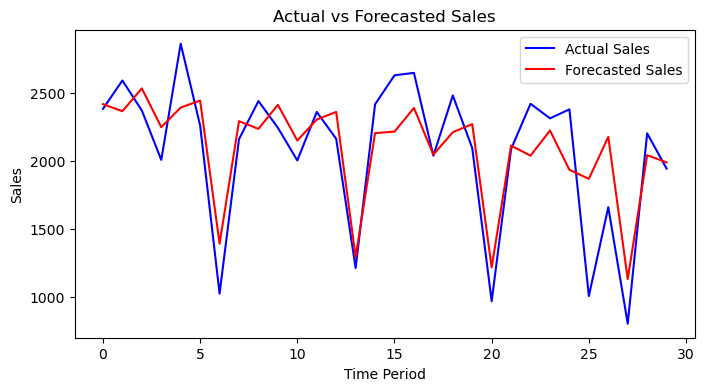

In [262]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test_beverages_fb, y_pred_beverages)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test_beverages_fb, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_beverages, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('FB_Beverages.png', bbox_inches='tight')
plt.show()

## Dairy

In [263]:
# Prophet model
model_fb = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=False)
# Add regressors
model_fb.add_regressor('onpromotion')
model_fb.add_regressor('dcoilwtico')
model_fb.add_regressor('year')
model_fb.add_regressor('month')
model_fb.add_regressor('national_holiday')
model_fb.add_regressor('day')
model_fb.add_regressor('day_name')
# Fit the model
model_fb.fit(df_dairy_fb_train)
# Forecast the sales
forecast_fb = model_fb.predict(df_dairy_fb_test)
# Model Predictions
y_pred_dairy = forecast_fb['yhat']

20:35:55 - cmdstanpy - INFO - Chain [1] start processing
20:35:55 - cmdstanpy - INFO - Chain [1] done processing


In [264]:
# Evaluation Metrics
evaluation_metrics(y_test_dairy_fb, y_pred_dairy)

{'MAE': 67.6658412376226,
 'MSE': 7036.901328626465,
 'MAPE': 11.07920491795388,
 'RMSE': 83.88624040107213,
 'R2 Score': 0.7462263723208273}

R2 score of 30 days Forecasted Sales :  0.7462263723208273 



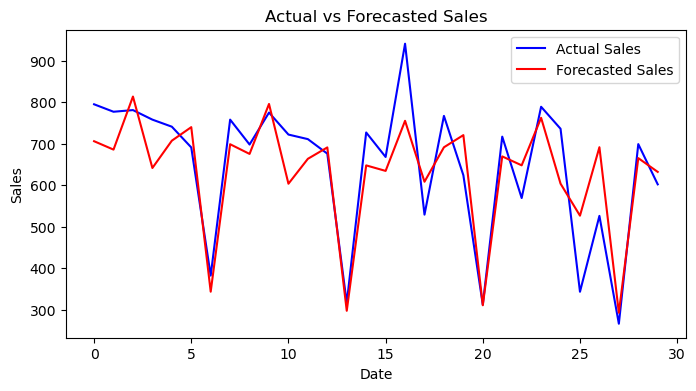

In [265]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test_dairy_fb, y_pred_dairy)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test_dairy_fb, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_dairy, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.legend()
plt.savefig('FB_Dairy.png', bbox_inches='tight')
plt.show()

## Grocery

In [266]:
# Prophet model
model_fb = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=False)
# Add regressors
model_fb.add_regressor('onpromotion')
model_fb.add_regressor('dcoilwtico')
model_fb.add_regressor('year')
model_fb.add_regressor('month')
model_fb.add_regressor('national_holiday')
model_fb.add_regressor('day')
model_fb.add_regressor('day_name')
# Fit the model
model_fb.fit(df_grocery_fb_train)
# Forecast the sales
forecast_fb = model_fb.predict(df_grocery_fb_test)
# Model Predictions
y_pred_grocery = forecast_fb['yhat']

20:37:53 - cmdstanpy - INFO - Chain [1] start processing
20:37:53 - cmdstanpy - INFO - Chain [1] done processing


In [267]:
# Evaluation Metrics
evaluation_metrics(y_test_grocery_fb, y_pred_grocery)

{'MAE': 235.86073099762507,
 'MSE': 113447.18134879459,
 'MAPE': 12.285041418906829,
 'RMSE': 336.8192116682102,
 'R2 Score': 0.7346538978881116}

R2 score of 30 days Forecasted Sales :  0.7346538978881116 



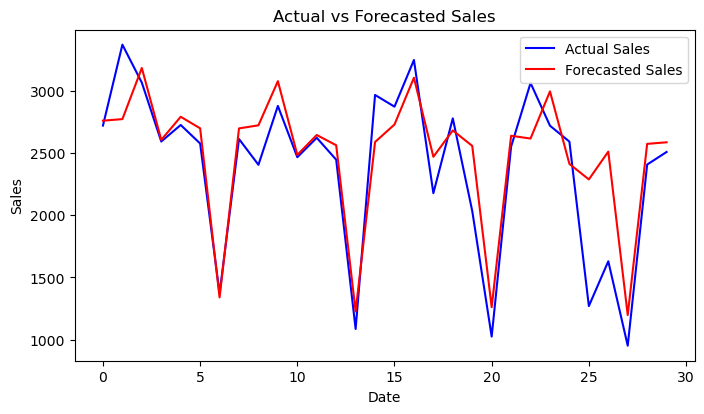

In [270]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test_grocery_fb, y_pred_grocery)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4.30))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test_grocery_fb, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_grocery, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.legend()
plt.savefig('FB_Grocery.png', bbox_inches='tight')
plt.show()

# LSTM

## Parameter Tuning

### Tanh Activation Function

In [23]:
# List to store parameters and R2 score
LSTM_optimal_parms_r2_list = []
for l in range(len(dfs_scaled[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    LSTM_optimal_parms_r2_dict = {}
    for i in [7,14,21,28,56,70,84,100]:
        for j in [8,16,24,32,64]:
            for k in [7,14]:
                for n in [0.0001,0.001,0.01]:
                    # Set random seeds for reproducibility
                    np.random.seed(42)
                    tf.random.set_seed(42)
                    random.seed(42)
                    # Early Stopping Criteria
                    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
                    # Train Test data
                    X, y = lag_features(dfs_scaled[0][l],k) #Optimal_params_LSTM[0][2]
                    X_train = X[:-301 ]
                    X_train = np.concatenate((X_train, dfs_external_scaled[0][l][k:-300]), axis=1) #Optimal_params_LSTM[0][2]
                    y_train = y[:-301]
                    X_val = X[-301:-1]
                    X_val = np.concatenate((X_val, dfs_external_scaled[0][l][-300:]), axis=1)
                    y_val = y[-301:-1]
                    X_test = X[-1].reshape(1,-1)
                    y_test = dfs_scaled[1][l]['sales'].values
                    # LSTM Model Architecture
                    model_LSTM = tf.keras.models.Sequential()
                    model_LSTM.add(LSTM(i, input_shape=(X_train.shape[1], 1), activation = 'tanh', recurrent_activation = "sigmoid")) #Optimal_params_LSTM[0][0]
                    model_LSTM.add(Dropout(0.1))
                    model_LSTM.add(Dense(1))
                    model_LSTM.compile(optimizer=Adam(learning_rate = n), loss='mean_squared_error') #Optimal_params_LSTM[0][1]
                    # Train the LSTM model
                    history = model_LSTM.fit(X_train, y_train, epochs=100, batch_size=j, validation_data=(X_val,y_val),
                                             callbacks = [early_stopping], verbose=0) #Optimal_params_LSTM[0][3], verbose=0
                    # Forecasting Sales
                    y_pred_LSTM = np.array([])
                    c=0
                    for m in range(forecast_days):
                        X_test_external = np.concatenate((X_test, dfs_external_scaled[1][l][c].reshape(1,-1)), axis=1)
                        y_new = model_LSTM.predict(X_test_external)
                        # Roll the array to the left
                        X_test = np.roll(X_test, -1)
                        # Set the last element to the new value
                        X_test[0,-1] = y_new
                        y_pred_LSTM = np.append(y_pred_LSTM,y_new)
                    # R2 Score
                    R2_score = r2_score(y_test, y_pred_LSTM)
                    LSTM_optimal_parms_r2_dict[i,j,k,n]=R2_score
                    # Print R2 score and params
                    print('no_of_neurons - ',i,#Optimal_params_LSTM[0][0],
                          '\nbatch_size - ',j,#Optimal_params_LSTM[0][3],
                          '\nno_of_lags - ',k,#Optimal_params_LSTM[0][2],
                          '\nlearning_rate - ',n,#Optimal_params_LSTM[0][2],
                          '\nR2 score: ',R2_score,'\n')
                
    optimal_params = max(LSTM_optimal_parms_r2_dict, key=LSTM_optimal_parms_r2_dict.get)
    print(f"{categories[l]} data optimal values for params neurons, learning_rate, lags and batch_size are : ",optimal_params)
    print("Maximum R2 Score is : ", LSTM_optimal_parms_r2_dict[optimal_params], '\n\n')
    LSTM_optimal_parms_r2_list.append(LSTM_optimal_parms_r2_dict)

# Print optimal values of parameters no_of_neurons, learning_rate, no_of_lags and batch_size
d=0
Optimal_params_LSTM = []
for i in LSTM_optimal_parms_r2_list:
    LSTM_optimal_params = max(i, key=i.get)
    Optimal_params_LSTM.append(LSTM_optimal_params)
    print(f"The optimal values for parameters neurons, learning_rate, lags and batch_size of {categories[d]} data: ", LSTM_optimal_params)
    print(f"Maximum R2 Score for {categories[d]} data is : ", i[LSTM_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

1/1 [==============================] - 0s 14ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  7 
learning_rate -  0.0001 
R2 score:  0.00016460870147294582 

1/1 [==============================] - 0s 17ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  7 
learning_rate -  0.001 
R2 score:  0.5975932480357631 

1/1 [==============================] - 0s 18ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  7 
learning_rate -  0.01 
R2 score:  0.4779909094330683 

1/1 [==============================] - 0s 16ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  14 
learning_rate -  0.0001 
R2 score:  -0.005458364905336133 

1/1 [==============================] - 0s 32ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  14 
learning_rate -  0.001 
R2 score:  0.0034672926178401786 

1/1 [==============================] - 0s 23ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  14 
learn

### RELU Activation Function

In [31]:
# List to store parameters and R2 score
LSTM_optimal_parms_r2_list = []
for l in range(len(dfs_scaled[0])):
    print(f"Parameter tuning of sales data related to {categories[l]} category - \n")
    # Dictionary to store parameters and R2 score
    LSTM_optimal_parms_r2_dict = {}
    for i in [7,14,21,28,56,70,84,100]:
        for j in [8,16,24,32,64]:
            for k in [7,14]:
                for n in [0.0001,0.001,0.01]:
                    # Set random seeds for reproducibility
                    np.random.seed(42)
                    tf.random.set_seed(42)
                    random.seed(42)
                    # Early Stopping Criteria
                    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
                    # Train Test data
                    X, y = lag_features(dfs_scaled[0][l],k) #Optimal_params_LSTM[0][2]
                    X_train = X[:-301 ]
                    X_train = np.concatenate((X_train, dfs_external_scaled[0][l][k:-300]), axis=1) #Optimal_params_LSTM[0][2]
                    y_train = y[:-301]
                    X_val = X[-301:-1]
                    X_val = np.concatenate((X_val, dfs_external_scaled[0][l][-300:]), axis=1)
                    y_val = y[-301:-1]
                    X_test = X[-1].reshape(1,-1)
                    y_test = dfs_scaled[1][l]['sales'].values
                    # LSTM Model Architecture
                    model_LSTM = tf.keras.models.Sequential()
                    model_LSTM.add(LSTM(i, input_shape=(X_train.shape[1], 1), activation = 'relu', recurrent_activation = "sigmoid")) #Optimal_params_LSTM[0][0]
                    model_LSTM.add(Dropout(0.1))
                    model_LSTM.add(Dense(1))
                    model_LSTM.compile(optimizer=Adam(learning_rate = n), loss='mean_squared_error') #Optimal_params_LSTM[0][1]
                    # Train the LSTM model
                    history = model_LSTM.fit(X_train, y_train, epochs=100, batch_size=j, validation_data=(X_val,y_val),
                                             callbacks = [early_stopping], verbose=0) #Optimal_params_LSTM[0][3], verbose=0
                    # Forecasting Sales
                    y_pred_LSTM = np.array([])
                    c=0
                    for m in range(forecast_days):
                        X_test_external = np.concatenate((X_test, dfs_external_scaled[1][l][c].reshape(1,-1)), axis=1)
                        y_new = model_LSTM.predict(X_test_external)
                        # Roll the array to the left
                        X_test = np.roll(X_test, -1)
                        # Set the last element to the new value
                        X_test[0,-1] = y_new
                        y_pred_LSTM = np.append(y_pred_LSTM,y_new)
                    # R2 Score
                    R2_score = r2_score(y_test, y_pred_LSTM)
                    LSTM_optimal_parms_r2_dict[i,j,k,n]=R2_score
                    # Print R2 score and params
                    print('no_of_neurons - ',i,#Optimal_params_LSTM[0][0],
                          '\nbatch_size - ',j,#Optimal_params_LSTM[0][3],
                          '\nno_of_lags - ',k,#Optimal_params_LSTM[0][2],
                          '\nlearning_rate - ',n,#Optimal_params_LSTM[0][2],
                          '\nR2 score: ',R2_score,'\n')
                
    optimal_params = max(LSTM_optimal_parms_r2_dict, key=LSTM_optimal_parms_r2_dict.get)
    print(f"{categories[l]} data optimal values for params neurons, learning_rate, lags and batch_size are : ",optimal_params)
    print("Maximum R2 Score is : ", LSTM_optimal_parms_r2_dict[optimal_params], '\n\n')
    LSTM_optimal_parms_r2_list.append(LSTM_optimal_parms_r2_dict)

# Print optimal values of parameters no_of_neurons, learning_rate, no_of_lags and batch_size
d=0
Optimal_params_LSTM = []
for i in LSTM_optimal_parms_r2_list:
    LSTM_optimal_params = max(i, key=i.get)
    Optimal_params_LSTM.append(LSTM_optimal_params)
    print(f"The optimal values for parameters neurons, learning_rate, lags and batch_size of {categories[d]} data: ", LSTM_optimal_params)
    print(f"Maximum R2 Score for {categories[d]} data is : ", i[LSTM_optimal_params])
    d+=1

Parameter tuning of sales data related to BEVERAGES category - 

1/1 [==============================] - 0s 31ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  7 
learning_rate -  0.0001 
R2 score:  0.01205516440401877 

1/1 [==============================] - 0s 31ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  7 
learning_rate -  0.001 
R2 score:  0.21819540455365438 

1/1 [==============================] - 0s 16ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  7 
learning_rate -  0.01 
R2 score:  0.5378367095984067 

1/1 [==============================] - 0s 16ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  14 
learning_rate -  0.0001 
R2 score:  0.004179212526476461 

1/1 [==============================] - 0s 31ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  14 
learning_rate -  0.001 
R2 score:  0.3366776614100364 

1/1 [==============================] - 0s 30ms/step
no_of_neurons -  7 
batch_size -  8 
no_of_lags -  14 
learning_ra

## Optimal Model

### Beverages

In [234]:
# Set random seeds for reproducibility
np.random.seed(42)
tf.random.set_seed(42)
random.seed(42)
# Early Stopping Criteria
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
# Train Test data
X, y = lag_features(dfs_scaled[0][0],7) #Optimal_params_LSTM[0][2]
X_train = X[:-301 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][0][7:-300]), axis=1) #Optimal_params_LSTM[0][2]
y_train = y[:-301]
X_val = X[-301:-1]
X_val = np.concatenate((X_val, dfs_external_scaled[0][0][-300:]), axis=1)
y_val = y[-301:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][0]['sales'].values
# LSTM Model Architecture
model_LSTM = tf.keras.models.Sequential()
model_LSTM.add(LSTM(28, input_shape=(X_train.shape[1], 1), activation = 'tanh', recurrent_activation = "sigmoid")) #Optimal_params_LSTM[0][0]
model_LSTM.add(Dropout(0.1))
model_LSTM.add(Dense(1))
model_LSTM.compile(optimizer=Adam(learning_rate = 0.01), loss='mean_squared_error') #Optimal_params_LSTM[0][1]
# Train the LSTM model
history = model_LSTM.fit(X_train, y_train, epochs=100, batch_size=24, validation_data=(X_val,y_val),
                         callbacks = [early_stopping], verbose=0) #Optimal_params_LSTM[0][3], verbose=0
# Forecasting Sales
y_pred_LSTM = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][0][c].reshape(1,-1)), axis=1)
    y_new = model_LSTM.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    y_pred_LSTM = np.append(y_pred_LSTM,y_new)
# R2 Score
R2_score = r2_score(y_test, y_pred_LSTM)
# Print R2 score and params
print('no_of_neurons - ',28,#Optimal_params_LSTM[0][0],
      '\nbatch_size - ',24,#Optimal_params_LSTM[0][3],
      '\nno_of_lags - ',7,#Optimal_params_LSTM[0][2],
      '\nlearning_rate - ',0.01,
      '\nactivation_function - ','tanh',
      '\nR2 score: ',R2_score,'\n')

1/1 [==============================] - 0s 33ms/step
no_of_neurons -  28 
batch_size -  24 
no_of_lags -  7 
learning_rate -  0.01 
activation_function -  tanh 
R2 score:  0.6605129862534654 



In [235]:
# Evaluation Metrics
y_test=scaler_1.inverse_transform(y_test.reshape(-1, 1))
y_pred_LSTM = scaler_1.inverse_transform(y_pred_LSTM.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_LSTM)

{'MAE': 218.0855980856025,
 'MSE': 97006.84537086096,
 'MAPE': 12.697109257557464,
 'RMSE': 311.4592194346813,
 'R2 Score': 0.6605129862534653}

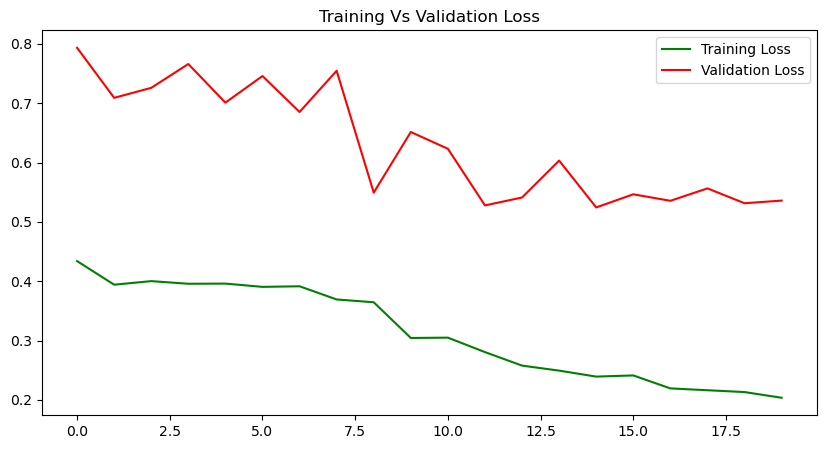

In [236]:
train_acc = history.history['loss']
val_acc = history.history['val_loss']

plt.figure(figsize = (10,5), dpi = 100)
plt.plot(train_acc, color = 'green', label = 'Training Loss')
plt.plot(val_acc, color = 'red', label = 'Validation Loss')
plt.title('Training Vs Validation Loss')
plt.legend()

R2 score of 30 days Forecasted Sales :  0.6605129862534653 



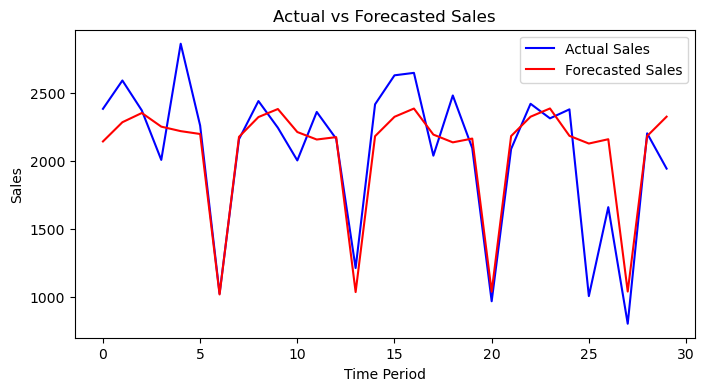

In [237]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_LSTM)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_LSTM, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('LSTM_Beverages.png', bbox_inches='tight')
plt.show()

### Dairy

In [238]:
# Set random seeds for reproducibility
np.random.seed(42)
tf.random.set_seed(42)
random.seed(42)
# Early Stopping Criteria
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
# Train Test data
X, y = lag_features(dfs_scaled[0][1],14) #Optimal_params_LSTM[0][2]
X_train = X[:-301 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][1][14:-300]), axis=1) #Optimal_params_LSTM[0][2]
y_train = y[:-301]
X_val = X[-301:-1]
X_val = np.concatenate((X_val, dfs_external_scaled[0][1][-300:]), axis=1)
y_val = y[-301:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][1]['sales'].values
# LSTM Model Architecture
model_LSTM = tf.keras.models.Sequential()
model_LSTM.add(LSTM(100, input_shape=(X_train.shape[1], 1), activation = 'relu', recurrent_activation = "sigmoid")) #Optimal_params_LSTM[0][0]
model_LSTM.add(Dropout(0.1))
model_LSTM.add(Dense(1))
model_LSTM.compile(optimizer=Adam(learning_rate = 0.01), loss='mean_squared_error') #Optimal_params_LSTM[0][1]
# Train the LSTM model
history = model_LSTM.fit(X_train, y_train, epochs=100, batch_size=64, validation_data=(X_val,y_val),
                         callbacks = [early_stopping], verbose=0) #Optimal_params_LSTM[0][3], verbose=0
# Forecasting Sales
y_pred_LSTM = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][1][c].reshape(1,-1)), axis=1)
    y_new = model_LSTM.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    y_pred_LSTM = np.append(y_pred_LSTM,y_new)
# R2 Score
R2_score = r2_score(y_test, y_pred_LSTM)
# Print R2 score and params
print('no_of_neurons - ',100,#Optimal_params_LSTM[0][0],
      '\nbatch_size - ',64,#Optimal_params_LSTM[0][3],
      '\nno_of_lags - ',14,#Optimal_params_LSTM[0][2],
      '\nlearning_rate - ',0.01,
      '\nactivation_function - ','relu',
      '\nR2 score: ',R2_score,'\n')

1/1 [==============================] - 0s 18ms/step
no_of_neurons -  100 
batch_size -  64 
no_of_lags -  14 
learning_rate -  0.01 
activation_function -  relu 
R2 score:  0.6991476883523202 



In [239]:
# Evaluation Metrics
y_test=scaler_2.inverse_transform(y_test.reshape(-1, 1))
y_pred_LSTM = scaler_2.inverse_transform(y_pred_LSTM.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_LSTM)

{'MAE': 61.8546718069731,
 'MSE': 8342.348458013748,
 'MAPE': 10.762256053250015,
 'RMSE': 91.33645744177814,
 'R2 Score': 0.6991476883523202}

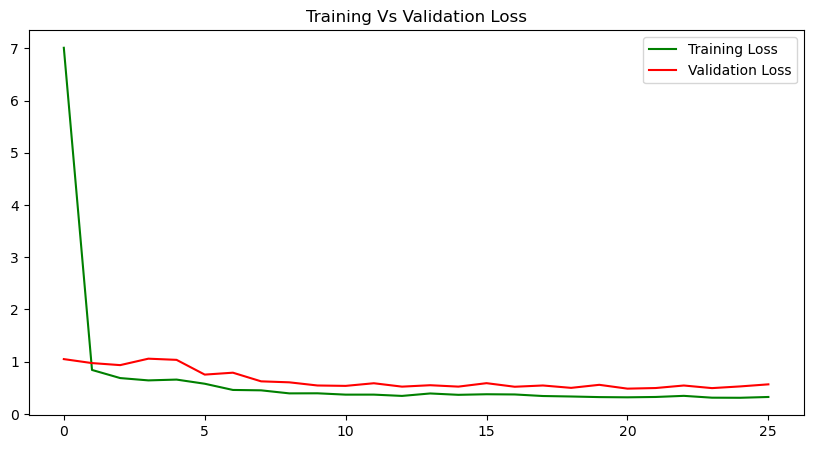

In [240]:
train_acc = history.history['loss']
val_acc = history.history['val_loss']

plt.figure(figsize = (10,5), dpi = 100)
plt.plot(train_acc, color = 'green', label = 'Training Loss')
plt.plot(val_acc, color = 'red', label = 'Validation Loss')
plt.title('Training Vs Validation Loss')
plt.legend()

R2 score of 30 days Forecasted Sales :  0.6991476883523202 



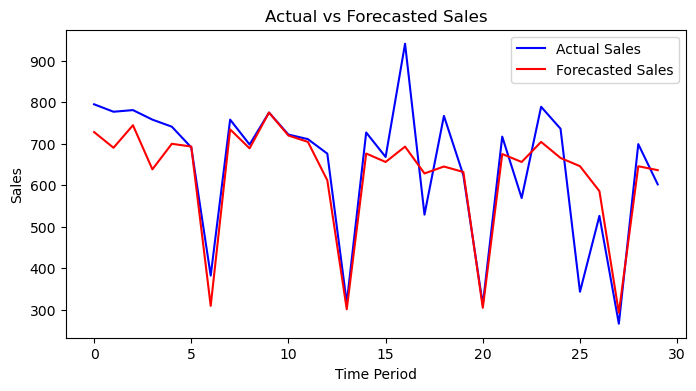

In [241]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_LSTM)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_LSTM, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('LSTM_Dairy.png', bbox_inches='tight')
plt.show()

### Grocery

In [242]:
# Set random seeds for reproducibility
np.random.seed(42)
tf.random.set_seed(42)
random.seed(42)
# Early Stopping Criteria
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
# Train Test data
X, y = lag_features(dfs_scaled[0][2],7) #Optimal_params_LSTM[0][2]
X_train = X[:-301 ]
X_train = np.concatenate((X_train, dfs_external_scaled[0][2][7:-300]), axis=1) #Optimal_params_LSTM[0][2]
y_train = y[:-301]
X_val = X[-301:-1]
X_val = np.concatenate((X_val, dfs_external_scaled[0][2][-300:]), axis=1)
y_val = y[-301:-1]
X_test = X[-1].reshape(1,-1)
y_test = dfs_scaled[1][2]['sales'].values
# LSTM Model Architecture
model_LSTM = tf.keras.models.Sequential()
model_LSTM.add(LSTM(84, input_shape=(X_train.shape[1], 1), activation = 'tanh', recurrent_activation = "sigmoid")) #Optimal_params_LSTM[0][0]
model_LSTM.add(Dropout(0.1))
model_LSTM.add(Dense(1))
model_LSTM.compile(optimizer=Adam(learning_rate = 0.01), loss='mean_squared_error') #Optimal_params_LSTM[0][1]
# Train the LSTM model
history = model_LSTM.fit(X_train, y_train, epochs=100, batch_size=24, validation_data=(X_val,y_val),
                         callbacks = [early_stopping], verbose=0) #Optimal_params_LSTM[0][3], verbose=0
# Forecasting Sales
y_pred_LSTM = np.array([])
c=0
for m in range(forecast_days):
    X_test_external = np.concatenate((X_test, dfs_external_scaled[1][2][c].reshape(1,-1)), axis=1)
    y_new = model_LSTM.predict(X_test_external)
    # Roll the array to the left
    X_test = np.roll(X_test, -1)
    # Set the last element to the new value
    X_test[0,-1] = y_new
    y_pred_LSTM = np.append(y_pred_LSTM,y_new)
# R2 Score
R2_score = r2_score(y_test, y_pred_LSTM)
# Print R2 score and params
print('no_of_neurons - ',100,#Optimal_params_LSTM[0][0],
      '\nbatch_size - ',24,#Optimal_params_LSTM[0][3],
      '\nno_of_lags - ',7,#Optimal_params_LSTM[0][2],
      '\nlearning_rate - ',0.01,
      '\nactivation_function - ','tanh',
      '\nR2 score: ',R2_score,'\n')

1/1 [==============================] - 0s 19ms/step
no_of_neurons -  100 
batch_size -  24 
no_of_lags -  7 
learning_rate -  0.01 
activation_function -  tanh 
R2 score:  0.700318122393677 



In [243]:
# Evaluation Metrics
y_test=scaler_3.inverse_transform(y_test.reshape(-1, 1))
y_pred_LSTM = scaler_3.inverse_transform(y_pred_LSTM.reshape(-1, 1))
evaluation_metrics(y_test,y_pred_LSTM)

{'MAE': 246.57110870499062,
 'MSE': 128127.24228907593,
 'MAPE': 12.508001803636182,
 'RMSE': 357.9486587334501,
 'R2 Score': 0.7003181223936767}

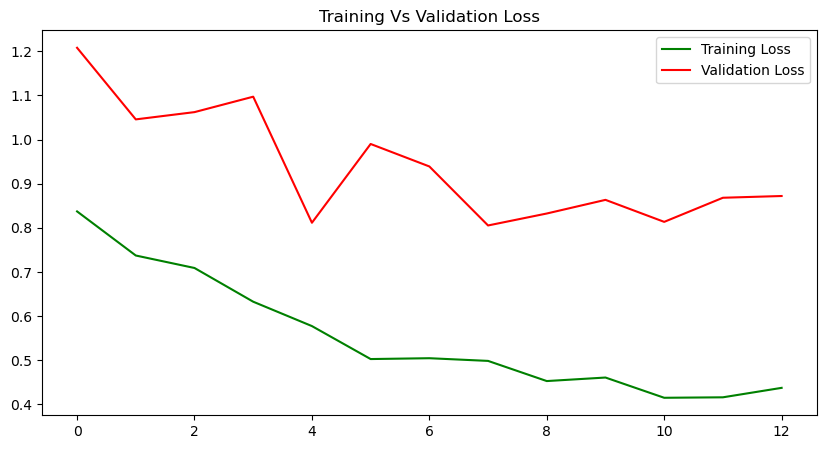

In [244]:
train_acc = history.history['loss']
val_acc = history.history['val_loss']

plt.figure(figsize = (10,5), dpi = 100)
plt.plot(train_acc, color = 'green', label = 'Training Loss')
plt.plot(val_acc, color = 'red', label = 'Validation Loss')
plt.title('Training Vs Validation Loss')
plt.legend()

R2 score of 30 days Forecasted Sales :  0.7003181223936767 



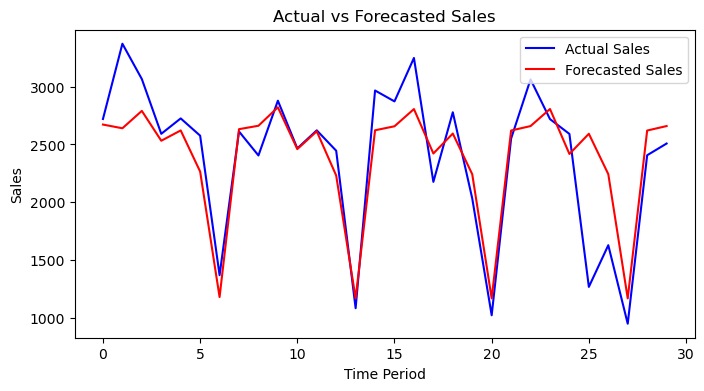

In [245]:
# 30 days Forecasted Sales
# R2 score
R2_score_30days = r2_score(y_test, y_pred_LSTM)
print('R2 score of 30 days Forecasted Sales : ',R2_score_30days,'\n')
# Plot the actual sales and forecasted sales
plt.figure(figsize=(8, 4))
#plt.plot(y_train, label = 'Actual Sales(Train)')
plt.plot(y_test, label = 'Actual Sales', color  = 'blue')
plt.plot(y_pred_LSTM, label = 'Forecasted Sales', color = 'red')
plt.title('Actual vs Forecasted Sales')
plt.xlabel('Time Period')
plt.ylabel('Sales')
plt.legend()
plt.savefig('LSTM_Grocery.png', bbox_inches='tight')
plt.show()